In [66]:
from __future__ import print_function, division
#Allows relative imports
import os, sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
#imports from files
from src.preprocessing import *
from src.train_eval_helpers import *
from src.VAE_train import *

from src.vautoencoders import *
#from loss_metrics import *
from src.plots import *
from src.pickling import *
from src.datasets import *

import pandas as pd 
import numpy as np
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

#checking gpu status
if torch.cuda.is_available():
    device = torch.device('cuda')
    print("Using : {}".format(device))
else:
    device = torch.device('cpu')
    print("Using : {}".format(device))
    
#Plot and stuff
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi']= 300
sns.set_style('darkgrid')


# Ignore warnings)
import warnings
warnings.filterwarnings("ignore")
    
%load_ext autoreload
%autoreload 2

Using : cuda
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Quick checks on the AE reconstruction (looks good)

In [6]:
### Model with positional information (and more latent dim) ###
model_pos = AutoEncoder(latent_dim = 50, aa_dim = 25, seq_len = 23, act=nn.SELU())
tmp = torch.load('./Best_AE_posEncode_WD_latdim50.pth.tar')
model_pos.load_state_dict(tmp['state_dict'])
###############################################################

### Normal AE without positional Encoding (best model) ###
model_reload =  AutoEncoder(latent_dim = 40, aa_dim = 21, 
                             seq_len = 23, act = nn.SELU())
chkpt = torch.load('./Best_AE_model_latdim40_withSELU.pth.tar')
model_reload.load_state_dict(chkpt['state_dict'])
##########################################################

<All keys matched successfully>

In [190]:
data = pd.read_csv('../training_data_new/emerson_raw/batch1/emerson_batch1_test_top10k_hla.tsv', sep='\t').query('len > 10 and len <=23').amino_acid.values
model_reload.to('cuda')
df3 = test_model(model_reload, nn.MSELoss(), data, 2**15, max_len= 23,
                weighted = 1.6, device = model_reload.encoder[0].weight.device,
                positional=False)

test set:   0%|          | 0/19 [00:00<?, ?it/s]

In [45]:
p = get_topk(get_patients(1, show=False),8, verbose=False)
_,_ = test_decode(model_pos, p.amino_acid.values, 8, positional=True)
_,_ = test_decode(model_reload, p.amino_acid.values, 8, positional=False)

dataset = get_topk(get_patients(5, show = False), 20000, verbose=False).amino_acid.values

df1 = test_model(model_pos, nn.MSELoss(), dataset, 2**15, max_len= 23,
                weighted = 1.6, device = model_pos.encoder[0].weight.device,
                positional=True)

df2 = test_model(model_reload, nn.MSELoss(), dataset, 2**15, max_len= 23,
                weighted = 1.6, device = model_reload.encoder[0].weight.device,
                positional=False)

	 Getting 1 patients
Length of df 39914
	 Getting the top 8

real:		CASSLGPGLVTYEQYFXXXXXXX
decoded:	CASSLGPGXXTYEQYFXXXXXXX

real:		CASSFGTSGENEQFFXXXXXXXX
decoded:	CASSFGTSGENEQFFXXXXXXXX

real:		CASSPQTSGGEQFFXXXXXXXXX
decoded:	CASSPQTSGGEQFFXXXXXXXXX

real:		CASSLQGSGNTIYFXXXXXXXXX
decoded:	CASSLQGSGNTXYFXXXXXXXXX

real:		CASSLGPGLVTYEQYFXXXXXXX
decoded:	CASSLGPGXXTYEQYFXXXXXXX

real:		CASSFGTSGENEQFFXXXXXXXX
decoded:	CASSFGTSGENEQFFXXXXXXXX

real:		CASSFGTSGENEQFFXXXXXXXX
decoded:	CASSFGTSGENEQFFXXXXXXXX

real:		CASSFGTSGENEQFFXXXXXXXX
decoded:	CASSFGTSGENEQFFXXXXXXXX

real:		CASSLQGSGNTIYFXXXXXXXXX
decoded:	CASSLXGSGNTXYFXXXXXXXXX

real:		CASSLGPGLVTYEQYFXXXXXXX
decoded:	CASSLGPGLVTYEQYFXXXXXXX

real:		CASSFVSSGYNEQFFXXXXXXXX
decoded:	CASSXVSSGYNEQFFXXXXXXXX

real:		CASSLNFMAGQETQYFXXXXXXX
decoded:	CASSLXXXAGQETQYFXXXXXXX

real:		CASSLQGSGNTIYFXXXXXXXXX
decoded:	CASSLXGSGNTXYFXXXXXXXXX

real:		CASSLGPGLVTYEQYFXXXXXXX
decoded:	CASSLGPGLVTYEQYFXXXXXXX

real:		CASSDSGGSGANVLTFXXXXXX

test set:   0%|          | 0/4 [00:00<?, ?it/s]

test set:   0%|          | 0/4 [00:00<?, ?it/s]

In [46]:
print('With positional encoding')
display(df1)
print('Without positional encoding')
display(df2)

With positional encoding


,Accuracy,Precision,Recall,F1_score,Hamming_loss,Criterion_loss
mean,0.976665,0.568792,0.908724,0.697751,0.023335,0.003487
var,0.0,0.0,0.0,0.0,0.0,0.0


Without positional encoding


,Accuracy,Precision,Recall,F1_score,Hamming_loss,Criterion_loss
mean,0.978618,0.589168,0.941041,0.722632,0.021382,0.002665
var,0.0,0.0,0.0,0.0,0.0,0.0


#### Same on VAE (Doesn't work)

In [177]:
_, _, test_dataset  = load_naive_dataset('../training_data_new/db_TRB.csv')

In [178]:
model_vae =  VAE(latent_dim = 40, aa_dim = 21, 
                 seq_len = 23, act = nn.SELU())
chkpt = torch.load('./VAE-Redo-MSE-Weighted_latent40_SELU_WD-adaptive_lr0.001.pth.tar')
model_vae.load_state_dict(chkpt['state_dict'])
model_vae.eval()
test_decode(model_vae, test_dataset, n=5)

False

real:		CSVGGLMADTQYFXXXXXXXXXX
decoded:	CASSLGGGGGEQFFFFFFXXXXX

real:		CASSQGAYEQYFXXXXXXXXXXX
decoded:	CASSLGGGGGEQFFFFFFXXXXX

real:		CASSLRATYNEQFFXXXXXXXXX
decoded:	CASSLGGGGGEQFFFFFFXXXXX

real:		CASSLSGESAYEQFFXXXXXXXX
decoded:	CASSLGGGGGEQFFFFFFXXXXX

real:		CASRGGSTEAFFXXXXXXXXXXX
decoded:	CASSLGGGGGEQFFFFFFXXXXX


(array(['CSVGGLMADTQYFXXXXXXXXXX', 'CASSQGAYEQYFXXXXXXXXXXX',
        'CASSLRATYNEQFFXXXXXXXXX', 'CASSLSGESAYEQFFXXXXXXXX',
        'CASRGGSTEAFFXXXXXXXXXXX'], dtype=object),
 array(['CASSLGGGGGEQFFFFFFXXXXX', 'CASSLGGGGGEQFFFFFFXXXXX',
        'CASSLGGGGGEQFFFFFFXXXXX', 'CASSLGGGGGEQFFFFFFXXXXX',
        'CASSLGGGGGEQFFFFFFXXXXX'], dtype=object))

# Embeddings visualization:

In [5]:
emerson = pd.read_csv('../training_data_new/emerson_raw/batch1/emerson_batch1_626hla_parsed_tagged.tsv', sep='\t')
sample_tags = pd.read_csv('../training_data_new/emerson_raw/batch1/emerson_batch1_sampletags.tsv', sep ='\t')

## Viz & computation functions here

In [63]:
def mask_seq(df):
    df['X']= 'X'
    df['masked_vj'] = 4*'X'+df['amino_acid'].str.slice(4,-4,1)+4*'X'# Getting X in V/J regions
    df['masked_centre'] = df['amino_acid'].str.slice(0,4,1)+df['X'].str.repeat(df['amino_acid'].str.len()-8)+df['amino_acid'].str.slice(-4,-1,1)+'F'
    df.drop(columns='X', inplace=True)
    return df

plot

In [182]:
def get_reduc(df, model, reduc='TSNE', positional=False, n_c = 2):
    if reduc == 'TSNE':
        reducer = TSNE(n_components = n_c, random_state=42)
    elif reduc == 'PCA':
        reducer = PCA(n_components = n_c, random_state = 42)
    elif reduc == 'UMAP':
        reducer = umap.UMAP(n_components = n_c, random_state=42)
        
    model_device = next(model_reload.children())[0].weight.device
    print('\t Onehot-encoding.')
    model.eval()
    onehot = onehot_batch(df.amino_acid.values, weighted = 1.6,
                          max_len = 23, positional = positional)
    onehot = onehot.to(model_device)
    print(f'\t Embedding {onehot.shape[0]} sequences.')
    if model.__class__.__name__ == 'AutoEncoder':
        embedding, _ = model(onehot)
    elif model.__class__.__name__ == 'VAE':
        _, embedding, _ = model(onehot) 
        #In eval mode, reparameterise just outputs mu, which is the "embedding"
    embedding = embedding.detach().cpu().numpy()

    print(f'\t Fitting {reduc}.')
    results = reducer.fit_transform(embedding)
    print('\t Waiting on plotting.')
    for i in range(results.shape[1]):
        df[f'{reduc}_'+str(i+1)] = results[:,i]
    return df

def plot_reduc(df, hue, name, reduc = 'TSNE', palette = 'seismic_r', comp = True):
    unique = len(df[hue].unique())
    sns.set_palette(palette, unique)
    MARKERS = ['X','P','D','s','o','*']
    if unique > 6:
        MARKERS = ['X']*unique
    vars_= [z for z in df.columns if z.startswith(reduc)]
    g = sns.PairGrid(df, x_vars = vars_,
                     y_vars = vars_,
                     diag_sharey=False, hue=hue,
                     hue_kws = {'markers':MARKERS[:unique]})
    if comp == True : 
        title = f'{name} TCR, {reduc} with {len(vars_)} components'
        adjust = 0.91
    elif comp == False:
        classes = '//'.join(sample_tags.query('filename in @df.filename.unique()')['class'].values)
        title = f'{name} TCR, {reduc} with {len(vars_)} components\n'\
                   f'HLA Classes : {classes}'
        adjust = 0.89
        
    g.fig.suptitle(title, fontweight='bold')
    g.fig.subplots_adjust(top=adjust)
    
    g.map_lower(sns.scatterplot,  alpha=0.8, size = df[hue],
                markers= MARKERS[:unique], style = df[hue],
                sizes=[3]*unique)
    g.map_upper(sns.kdeplot, levels = 8, alpha = 0.75)
    g.map_diag(sns.kdeplot)
    g.add_legend()

tsne/pca

In [127]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

def get_patients(n=2, show =True):
    print(f'\t Getting {n} patients')
    fn = np.random.choice(sample_tags.filename.unique(), n)
    patients_queried = emerson.query('filename in @fn')
    print(f'Length of df {len(patients_queried)}')
    if show == True:
        display(sample_tags.query('filename in @fn')[['filename','age', 'sex', 'race', 'hla_a1',
                                                      'hla_a2', 'hla_b1', 'hla_b2', 'class']])
        aas = patients_queried.query('filename==@fn[0]').amino_acid.values
        print("Total shared : ", len(patients_queried.query('filename==@fn[1] and amino_acid in @aas')))
    return patients_queried.query('len>10 and len<=23')

def get_topk(df, topk=2500, verbose=True):
    print(f'\t Getting the top {topk}')
    top = df.sort_values('frequency', ascending=False)\
            .groupby('filename').head(topk)
    fn_ = top.filename.unique()
    if verbose:
        aas = top.query("filename in @fn_[1]").amino_acid.values
        len_shared = len(top.query('filename==@fn_[0] and amino_acid in @aas'))
        print(f"# Shared in top {topk} seqs : {len_shared}")
        return top, len_shared
    else:
        return top

def get_pca(df, model, positional = False, n_comp = 2):
    pca = PCA(n_components = n_comp, random_state = 42)
    model_device = next(model_reload.children())[0].weight.device
    print('\t Onehot-encoding.')
    model.eval()
    onehot = onehot_batch(df.amino_acid.values, weighted = 1.6,
                          max_len = 23, positional = positional)
    onehot = onehot.to(model_device)
    print(f'\t Embedding {onehot.shape[0]} sequences.')
    if model.__class__.__name__ == 'AutoEncoder':
        embedding, decoded = model(onehot)
    elif model.__class__.__name__ == 'VAE':
        _, embedding, _ = model(onehot) 
        #In eval mode, reparameterise just outputs mu, which is the "embedding"
    embedding = embedding.detach().cpu().numpy()
    print(f'\t Fitting PCA with {n_comp} components')
    results = pca.fit_transform(embedding)
    print('\t Waiting on plotting.')
    for i in range(results.shape[1]+1):
        df['PCA_'+str(i+1)] = results[:,i]
    return df

def get_tsne(df, model, positional = False, n_comp = 2):
    tsne = TSNE(n_components = n_comp, random_state = 42)
    model_device = next(model_reload.children())[0].weight.device
    print('\t Onehot-encoding.')
    model.eval()
    onehot = onehot_batch(df.amino_acid.values, weighted = 1.6,
                          max_len = 23, positional = positional)
    onehot = onehot.to(model_device)
    print(f'\t Embedding {onehot.shape[0]} sequences.')
    if model.__class__.__name__ == 'AutoEncoder':
        embedding, decoded = model(onehot)
    elif model.__class__.__name__ == 'VAE':
        _, embedding, _ = model(onehot) 
        #In eval mode, reparameterise just outputs mu, which is the "embedding"
    embedding = embedding.detach().cpu().numpy()
    print(f'\t Fitting TSNE with {n_comp} components.')
    tsne_results = tsne.fit_transform(embedding)
    print('\t Waiting on plotting.')
    for i in range(tsne_results.shape[1]):
        df['TSNE_'+str(i+1)] = tsne_results[:,i]
    return df

def pipeline(model, n = 2, n_comp = 2, top_k=2500, positional = False,
             hue='filename', name='', palette='seismic_r'):
    pats = get_patients(n)
    topk, len_shared = get_topk(pats, top_k)
    results = get_tsne(topk, model, positional = positional, n_comp = n_comp)
    plot_reduc(results, hue=hue, reduc = 'TSNE',
              name = name+f'Top {top_k}, with {len_shared} shared', 
              palette=palette)
    names = ('-').join([x.split('.tsv')[0] for x in pats.filename.unique()])
    plt.savefig('./tsne/random/'+name+'top_'+str(top_k)+names+f'_with_{str(len_shared)}_shared_TSNE.jpg',
                dpi = 300)
    return pats, results, names.split('-')

def pipeline_alt(model, df, n_comp = 2, top_k=2500, positional = False, hue='filename', name='', palette='seismic_r'):
    topk, len_shared = get_topk(df, top_k)
    results = get_tsne(topk, model, positional = positional, n_comp = n_comp)
    plot_reduc(results, hue=hue, reduc = 'TSNE',
              name = name+f'Top {top_k}, with {len_shared} shared', 
              palette=palette)
    names = ('-').join([x.split('.tsv')[0] for x in df.filename.unique()])
    plt.savefig('./tsne/'+name+'top_'+str(top_k)+names+f'_with_{str(len_shared)}_shared_TSNE.jpg',
                dpi = 300)
    return df, results, names.split('-')

umap

In [126]:
from sklearn.preprocessing import StandardScaler
import umap
def get_umap(df, model, positional=False, n_c = 2):
    reducer = umap.UMAP(n_components = n_c, random_state = 42)
    model_device = next(model_reload.children())[0].weight.device
    print('\t Onehot-encoding.')
    model.eval()
    onehot = onehot_batch(df.amino_acid.values, weighted = 1.6,
                          max_len = 23, positional = positional)
    onehot = onehot.to(model_device)
    print(f'\t Embedding {onehot.shape[0]} sequences.')
    if model.__class__.__name__ == 'AutoEncoder':
        embedding, _ = model(onehot)
    elif model.__class__.__name__ == 'VAE':
        _, embedding, _ = model(onehot) 
        #In eval mode, reparameterise just outputs mu, which is the "embedding"
    embedding = embedding.detach().cpu().numpy()
    #print('\t Standardizing.')
    #embedding = StandardScaler().fit_transform(embedding)
    print('\t Fitting UMAP.')
    umap_results = reducer.fit_transform(embedding)
    print('\t Waiting on plotting.')
    for i in range(results.shape[1]):
        df['UMAP_'+str(i+1)] = umap_results[:,i]
    return df

def plot_umap(df, hue, name, palette = 'seismic_r'):
    unique = len(df.filename.unique())
    sns.set_palette(palette, unique)
    MARKERS = ['X','P','D','s','o','*']
    classes = '//'.join(sample_tags.query('filename in @df.filename.unique()')['class'].values)
    vars_= [z for z in df.columns if z.startswith('UMAP')]
    g = sns.PairGrid(df, x_vars = vars_,
                     y_vars = vars_,
                     diag_sharey=False, hue=hue,
                     hue_kws = {'markers':MARKERS[:unique]})
    g.fig.suptitle(f'{name} TCR, UMAP with {len(vars_)} components\n'\
                   f'HLA Classes : {classes}',
                   fontweight='bold')
    g.fig.subplots_adjust(top=0.91)
    
    g.map_lower(sns.scatterplot,  alpha=0.8, size = df[hue],
                markers= MARKERS[:unique], style = df[hue],
                sizes=[3]*unique)
    g.map_upper(sns.kdeplot, levels = 8, alpha = 0.75)
    g.map_diag(sns.kdeplot)
    g.add_legend()
        
def pipeline_umap(model, n = 2, top_k=2500, positional = False,
             hue='filename', name='', palette='husl'):
    pats = get_patients(n)
    topk, len_shared = get_topk(pats, top_k)
    results = get_umap(topk, model, positional)
    plot_umap(results, hue=hue, 
              name = name+f'Top {top_k}, with {len_shared} shared', 
              palette=palette)
    names = ('-').join([x.split('.tsv')[0] for x in pats.filename.unique()])
    plt.savefig('./umap/top_'+str(top_k)+names+f'_with_{str(len_shared)}_shared_UMAP.jpg',
                dpi = 300)
    return pats, results, names.split('-')

def pipeline_umap_alt(model, df, top_k=2500, positional = False,
             hue='filename', name='', palette='husl'):
    topk, len_shared = get_topk(df, top_k)
    results = get_umap(topk, model, positional)
    plot_umap(results, hue=hue, 
              name = name+f'Top {top_k}, with {len_shared} shared', 
              palette=palette)
    names = ('-').join([x.split('.tsv')[0] for x in df.filename.unique()])
    plt.savefig('./umap/shared_class/'+str(top_k)+names+f'_with_{str(len_shared)}_shared_UMAP.jpg',
                dpi = 300)
    return df, results, names.split('-')

# Visualizations (With AutoEncoder): 

### TSNE

In [183]:
#Random comparisons with normal model
for i in range(10):
    _,_, filenames = pipeline(model_reload, 2, top_k=5000, hue = 'filename', palette='seismic_r')

	 Getting 2 patients
Length of df 78277


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
224,HIP08792.tsv,51,Male,Caucasian,A29,A31,B07,B44,A29-A31-B07-B44
614,HIP17698.tsv,43,Female,Caucasian,A02,A03,B08,B44,A02-A03-B08-B44


Total shared :  1307
	 Getting the top 5000
# Shared in top 5000 seqs : 28
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.


KeyboardInterrupt: 

	 Getting 2 patients
Length of df 79706


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
71,HIP01805.tsv,Unknown,Female,Unknown,A01,Unknown,B13,B35,A01-B13-B35
258,HIP09430.tsv,23,Female,Asian or Pacific Islander,A02,A26,B08,B40,A02-A26-B08-B40


Total shared :  1196
	 Getting the top 5000
# Shared in top 5000 seqs : 44
	 Onehot-encoding.
	 Embedding torch.Size([10000, 23, 25]) sequences.
torch.Size([10000, 50]) torch.Size([10000, 575])
torch.Size([10000, 50])
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79740


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
291,HIP10821.tsv,54,Male,Caucasian,A02,A26,B55,Unknown,A02-A26-B55
588,HIP14240.tsv,23,Female,Caucasian,A01,Unknown,B08,B35,A01-B08-B35


Total shared :  1179
	 Getting the top 5000
# Shared in top 5000 seqs : 24
	 Onehot-encoding.
	 Embedding torch.Size([10000, 23, 25]) sequences.
torch.Size([10000, 50]) torch.Size([10000, 575])
torch.Size([10000, 50])
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79783


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
3,HIP00602.tsv,45,Female,Unknown,A02,A11,B35,B51,A02-A11-B35-B51
251,HIP09235.tsv,51,Male,Caucasian,A02,Unknown,B35,B44,A02-B35-B44


Total shared :  1243
	 Getting the top 5000
# Shared in top 5000 seqs : 25
	 Onehot-encoding.
	 Embedding torch.Size([10000, 23, 25]) sequences.
torch.Size([10000, 50]) torch.Size([10000, 575])
torch.Size([10000, 50])
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 72956


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
238,HIP09026.tsv,39,Male,Black or African American,A03,A68,B41,B58,A03-A68-B41-B58
376,HIP13402.tsv,Unknown,Female,Unknown,A03,A30,B07,B13,A03-A30-B07-B13


Total shared :  868
	 Getting the top 5000
# Shared in top 5000 seqs : 33
	 Onehot-encoding.
	 Embedding torch.Size([10000, 23, 25]) sequences.
torch.Size([10000, 50]) torch.Size([10000, 575])
torch.Size([10000, 50])
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79824


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
145,HIP04510.tsv,49,Male,Unknown,A01,A30,B14,B35,A01-A30-B14-B35
313,HIP12099.tsv,18,Male,Native American or Alaska Native,A02,A68,B44,B60,A02-A68-B44-B60


Total shared :  1052
	 Getting the top 5000
# Shared in top 5000 seqs : 29
	 Onehot-encoding.
	 Embedding torch.Size([10000, 23, 25]) sequences.
torch.Size([10000, 50]) torch.Size([10000, 575])
torch.Size([10000, 50])
	 Fitting TSNE.
	 Waiting on plotting.


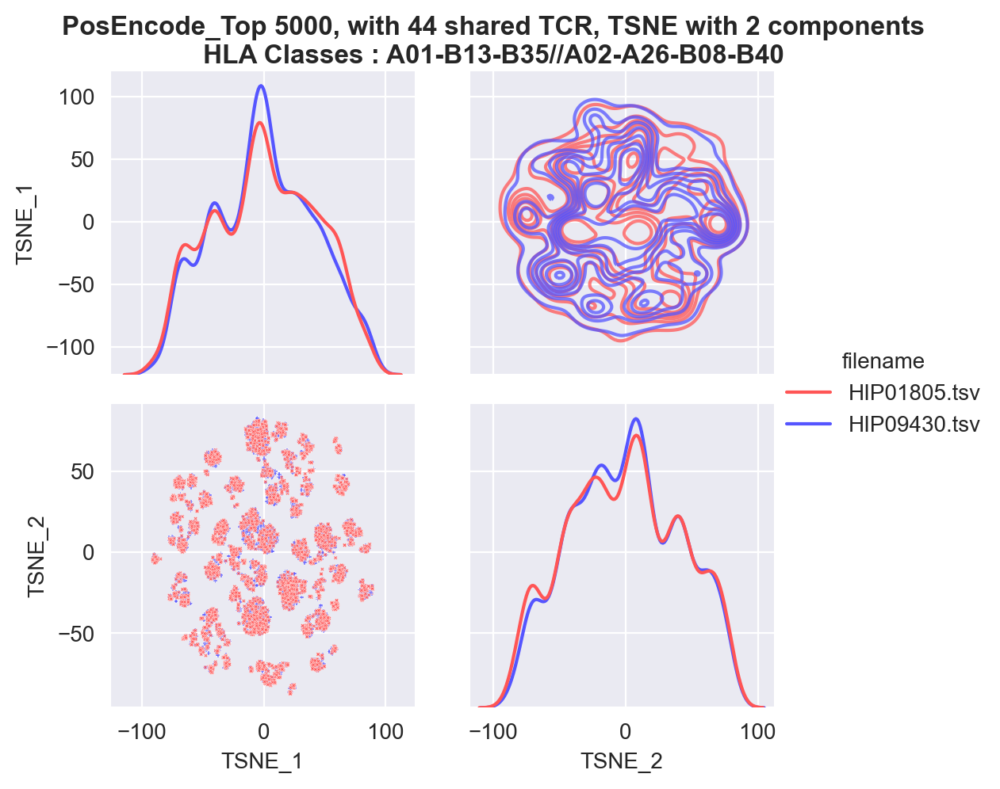

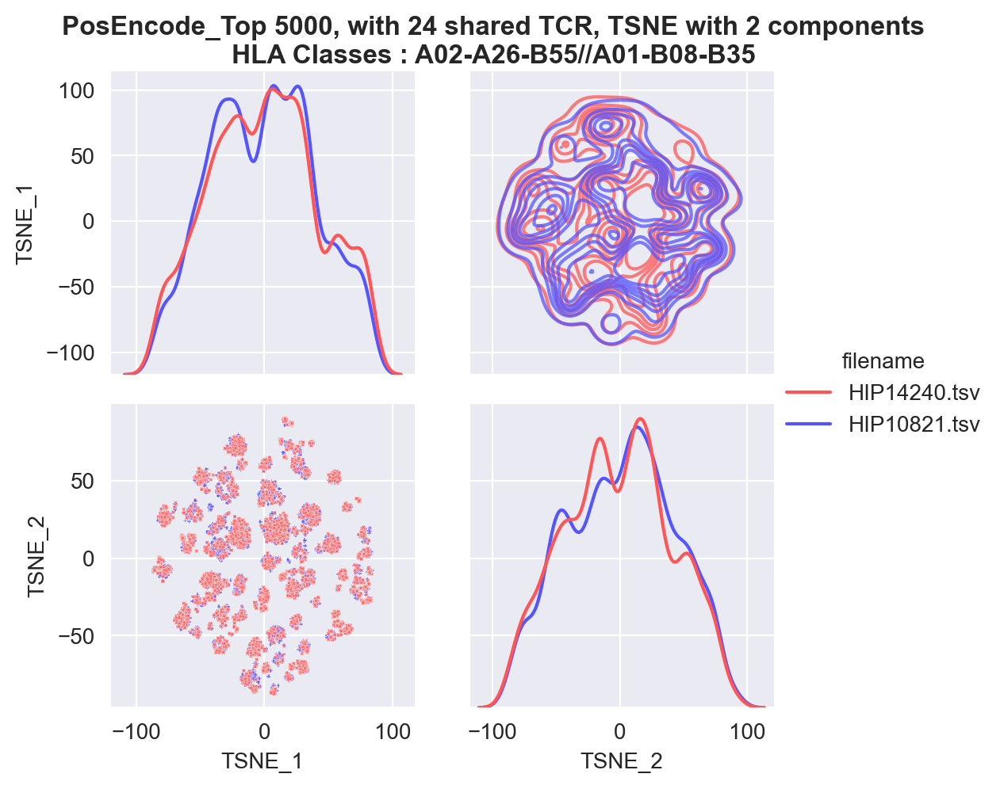

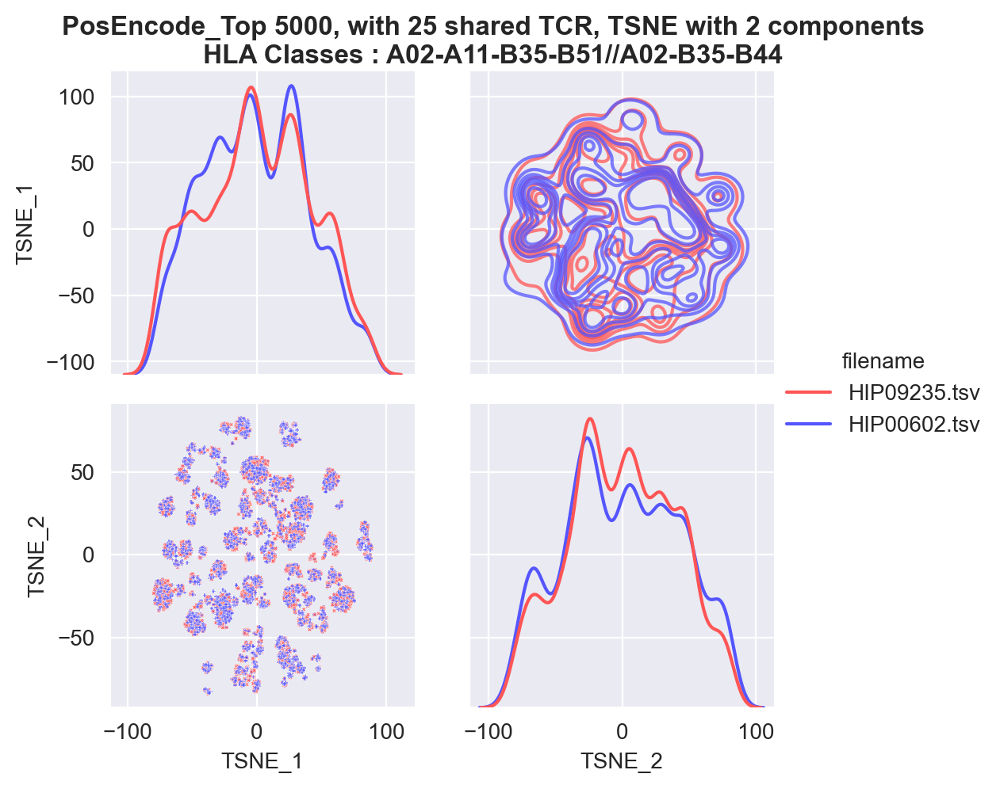

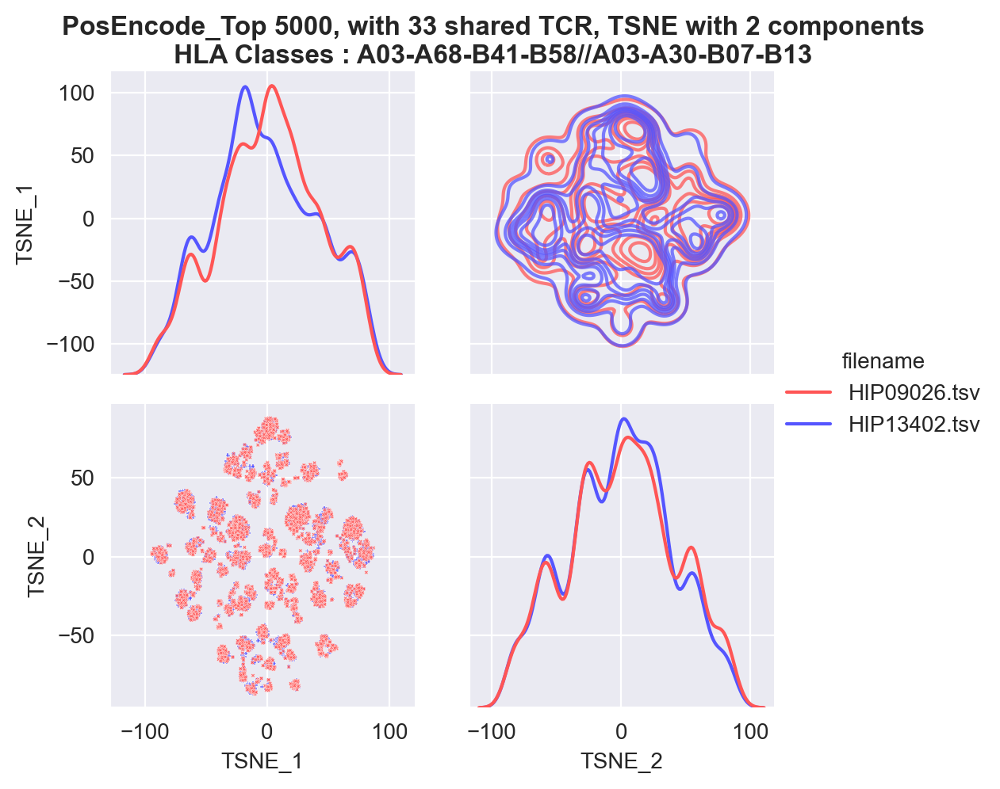

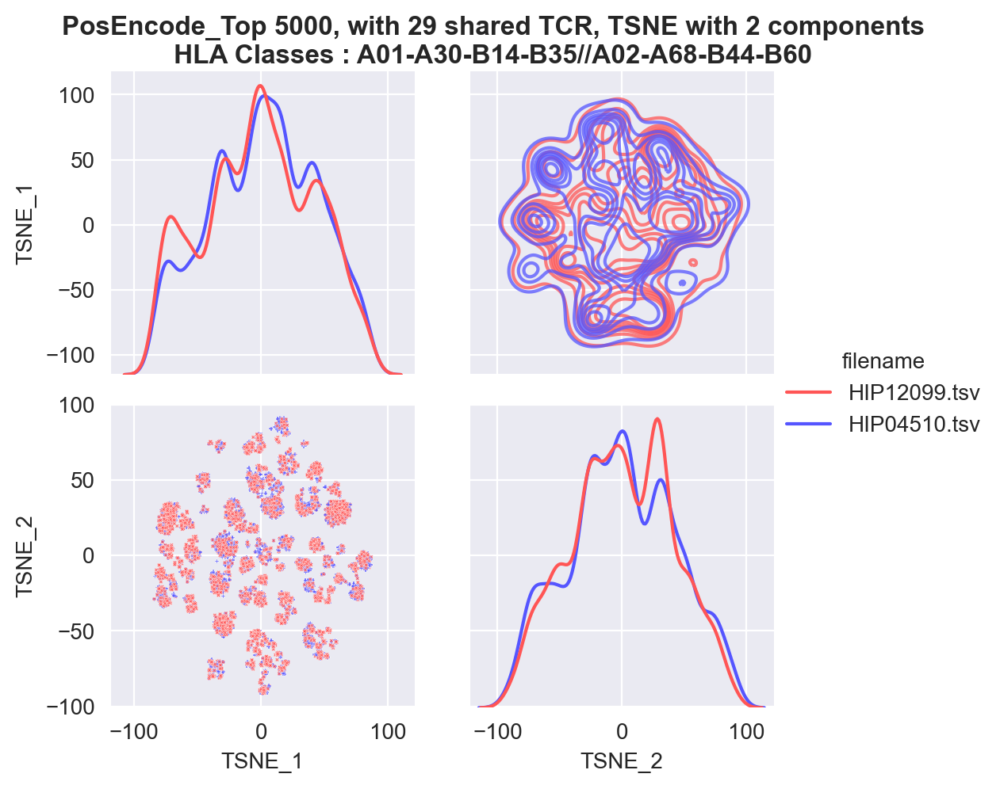

In [103]:
# Random patients with positional encoding
for i in range(5):
    _,_, filenames = pipeline(model_pos, 2, top_k=5000, positional = True, hue = 'filename',
                              name = 'PosEncode_', palette='seismic_r')

In [52]:
#Comparing patients with same HLA genotype
shared_classes = sample_tags.groupby('class').count().sort_values('filename',ascending=False).head(9).index[:7]
for c in shared_classes:
    fns = sample_tags.query('`class`== @c').filename.unique()
    sub = emerson.query('filename in @fns and len>10 and len <=23')
    _ =pipeline_alt(model_reload, sub, top_k = 2500, 
                    hue = 'filename', name = 'CLASS-'+c,
                   palette = 'gist_ncar')

	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 15000 sequences.
	 Fitting TSNE.


KeyboardInterrupt: 

In [152]:
# COMPARING TOP 500
fn_true  = sample_tags.query('true_cmv=="1"').sample(50).filename.values
fn_false = sample_tags.query('true_cmv=="0"').sample(50).filename.values
fn_total = np.append(fn_true, fn_false)
sub = get_topk(emerson.query('filename in @fn_total and len > 10 and len <= 23'), 1000, verbose= False)
tmp = get_reduc(sub, model_reload, reduc = 'TSNE', positional = False)
plot_reduc(tmp, hue='CMV', name='top500 TCR for CMV Comparison-:', reduc='TSNE',
          comp = True, palette = 'seismic_r')
plt.savefig('../../../meetings/presentation_results/210322_update/top1k_50patients.jpg', dpi=300)


	 Getting the top 1000
	 Onehot-encoding.
	 Embedding 100000 sequences.
	 Fitting TSNE.


KeyboardInterrupt: 

In [223]:
tmp = get_umap(sub, model_reload, positional = False)

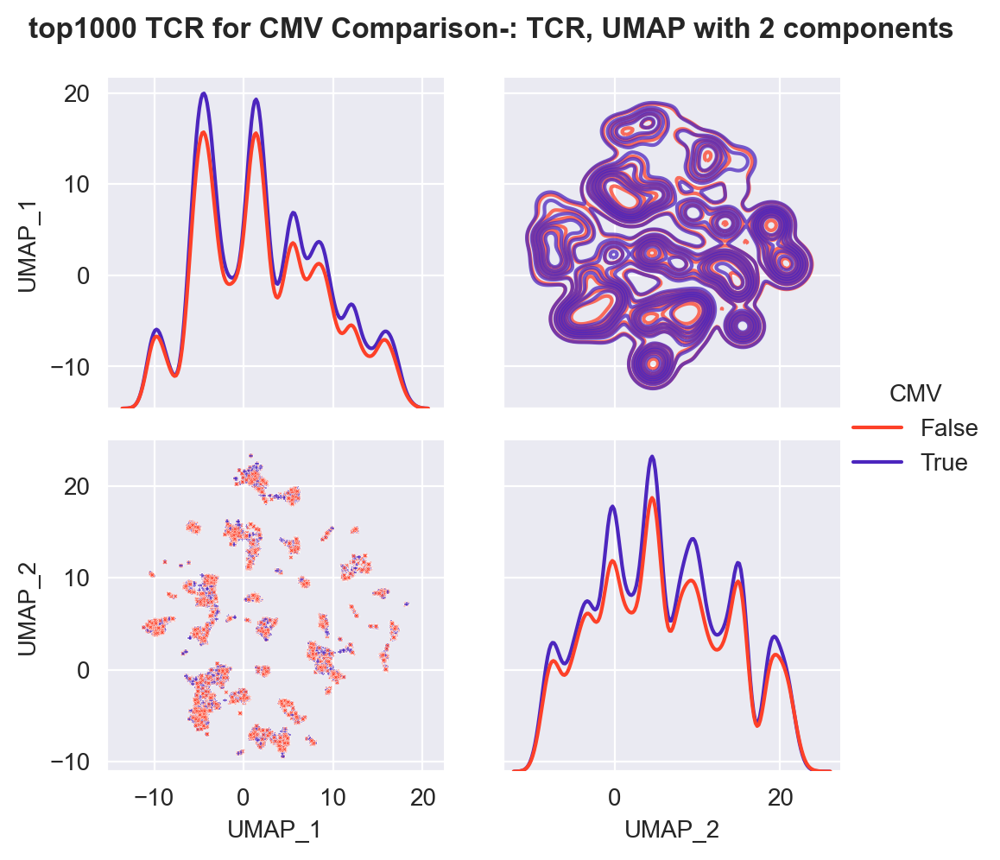

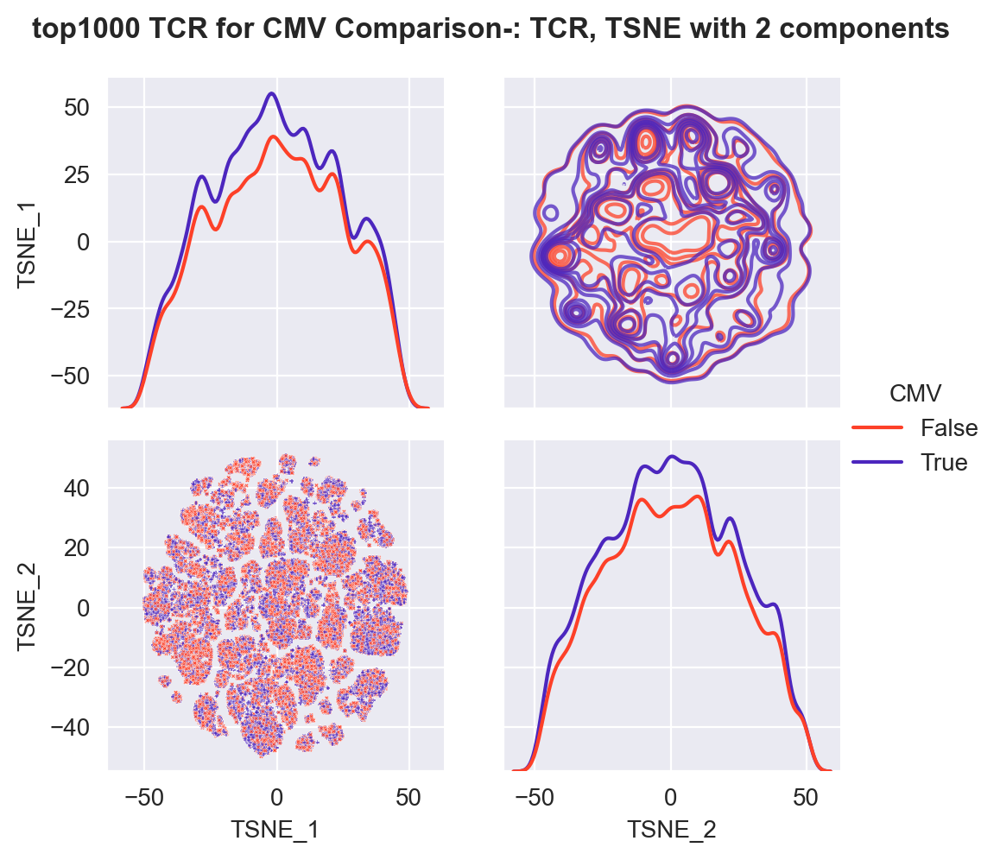

In [226]:
plot_reduc(tmp, hue='CMV', reduc = 'UMAP', name='top1000 TCR for CMV Comparison-:', 
          comp = True, palette = pal)
plt.savefig('./top1000_TCR_comp_CMV_UMAP.jpg', dpi = 300)
plot_reduc(tmp, hue='CMV', reduc = 'TSNE', name='top1000 TCR for CMV Comparison-:', 
          comp = True, palette = pal)
plt.savefig('./top1000_TCR_comp_CMV_TSNE.jpg', dpi = 300)


### Doing same patients but diff CMV 
Getting filenames here

In [155]:
shared_classes = sample_tags.groupby('class').count().sort_values('filename',ascending=False).head(9).index[:7]
fn0 = sample_tags.query('`class` == @shared_classes[0]').filename[0:4].values
fn1 = sample_tags.query('`class` == @shared_classes[1]').filename.values
fn2 = sample_tags.query('`class` == @shared_classes[2]').filename[0:4].values
fn3 = sample_tags.query('`class` == @shared_classes[3]').filename[0:4].values
fn4 = sample_tags.query('`class` == @shared_classes[4]').filename[0:2].values
fn5 = sample_tags.query('`class` == @shared_classes[5]').filename[2:].values
fn6 = sample_tags.query('`class` == @shared_classes[6]').filename[0:2].values

	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 24000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting TSNE with 2 components.
	 Waiting on plotting.


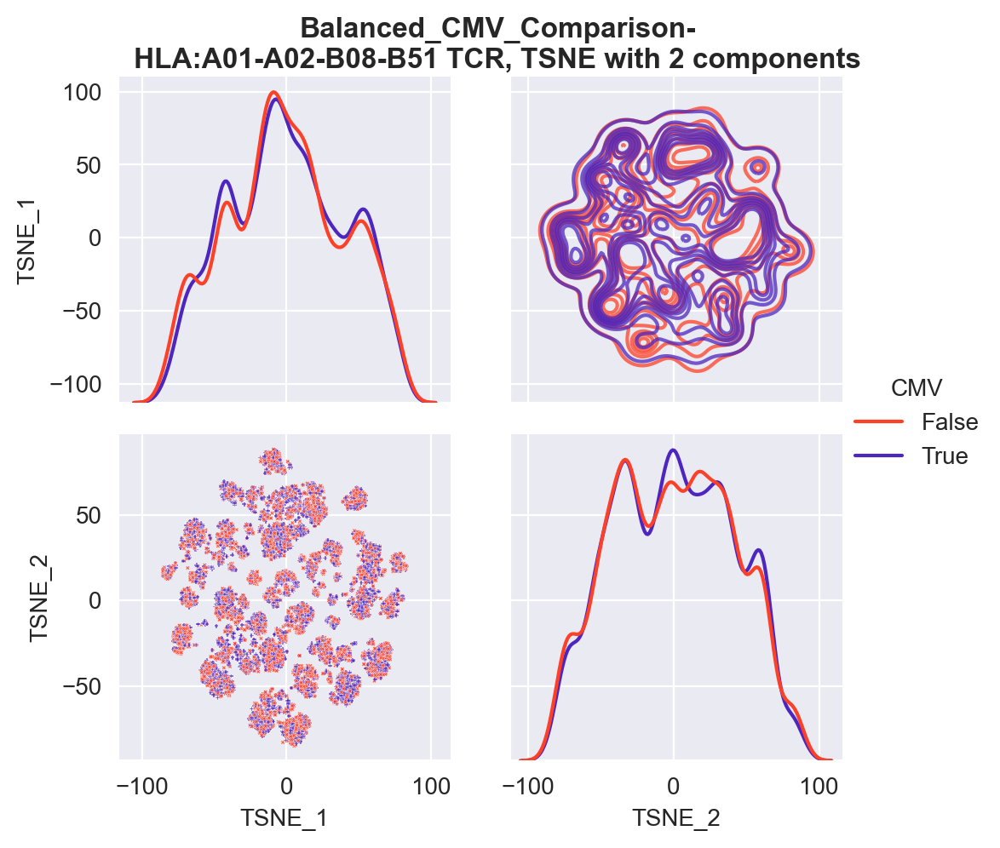

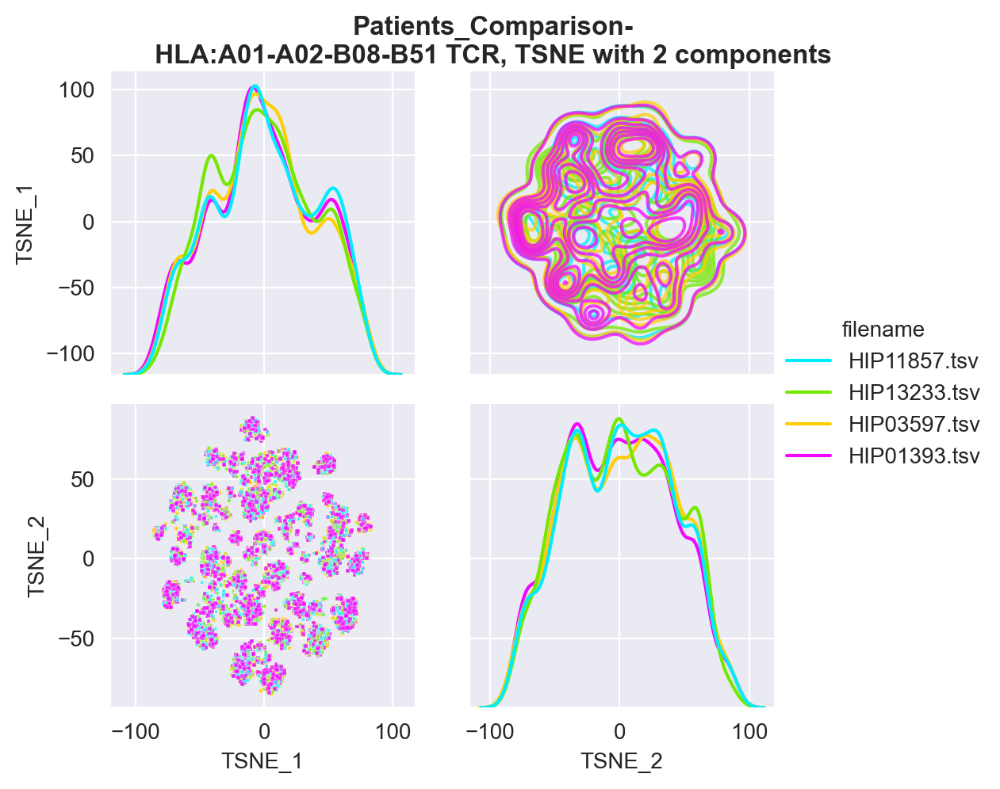

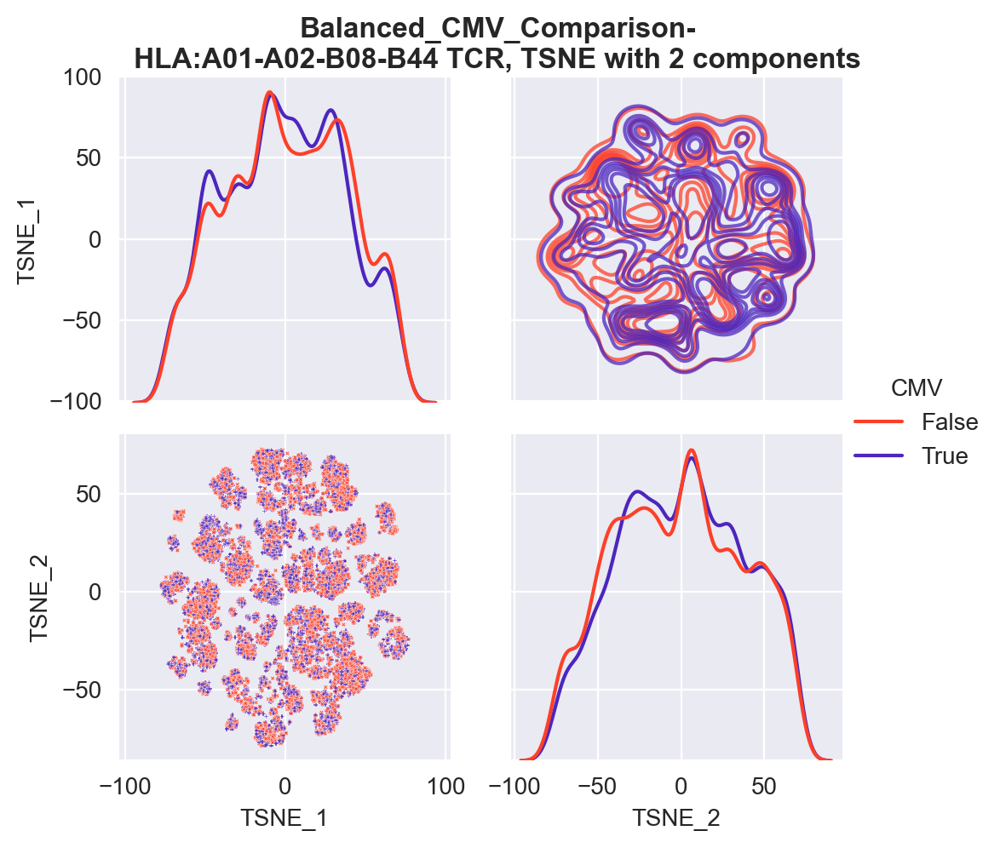

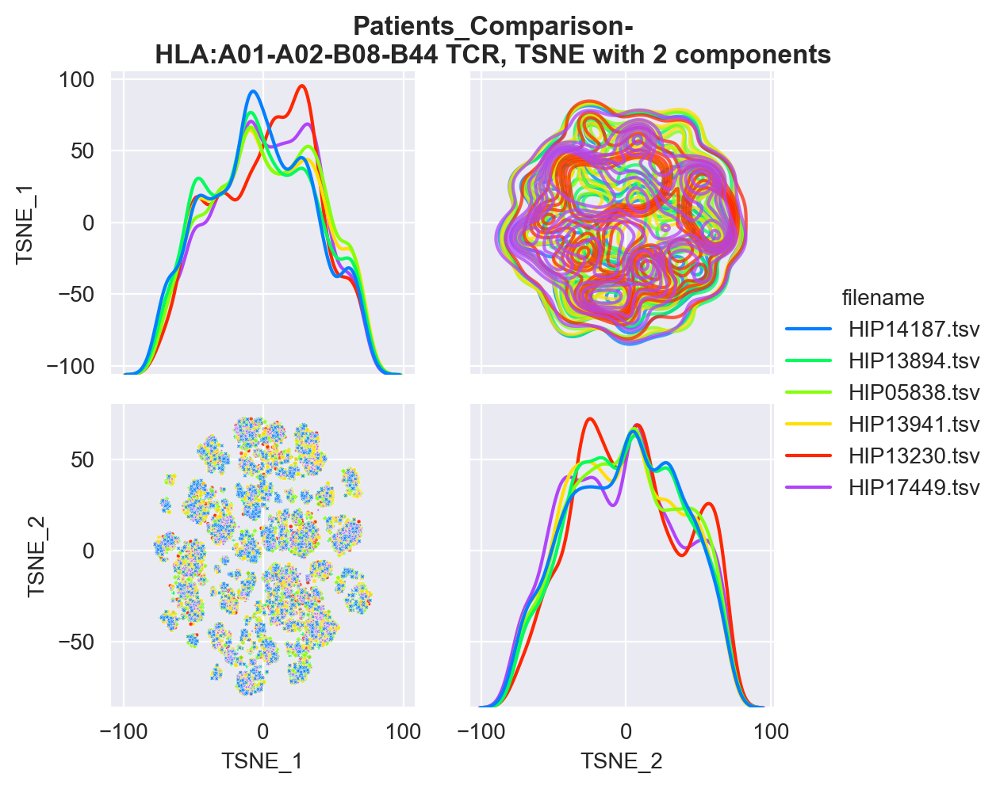

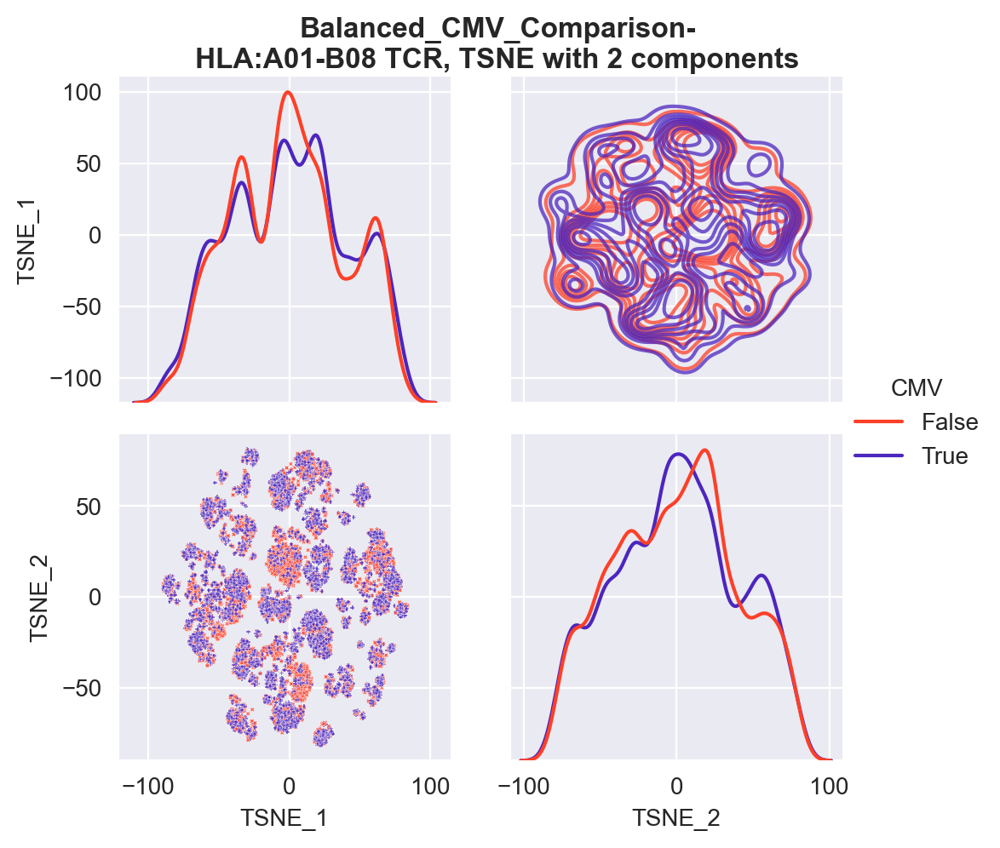

...

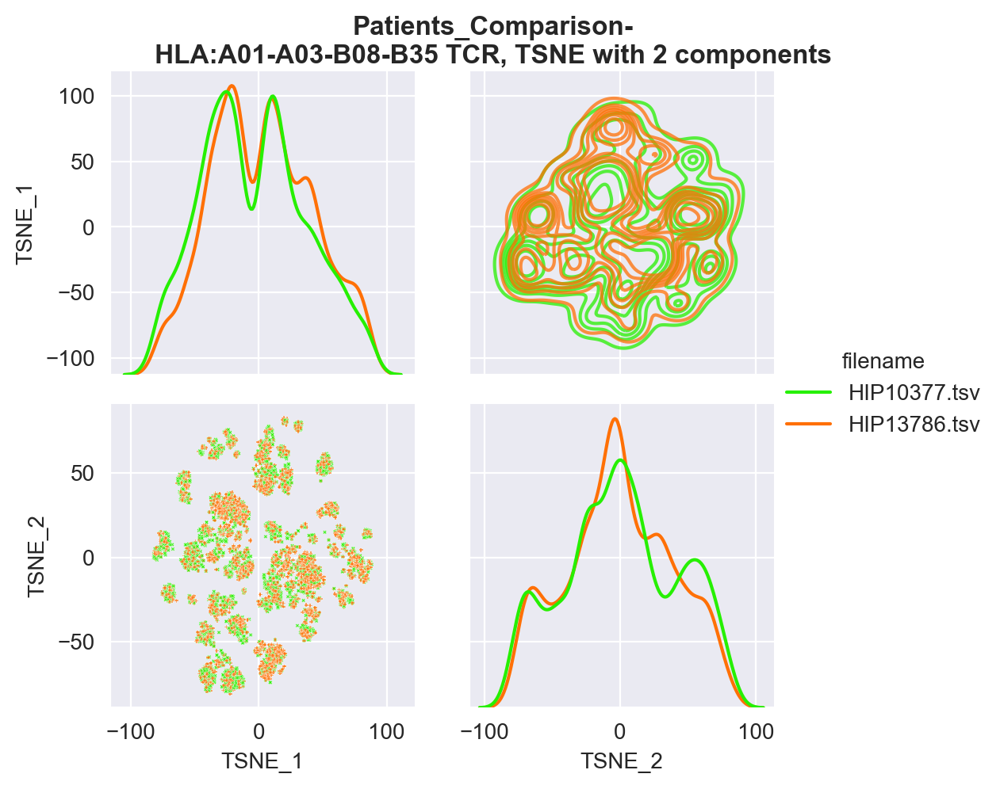

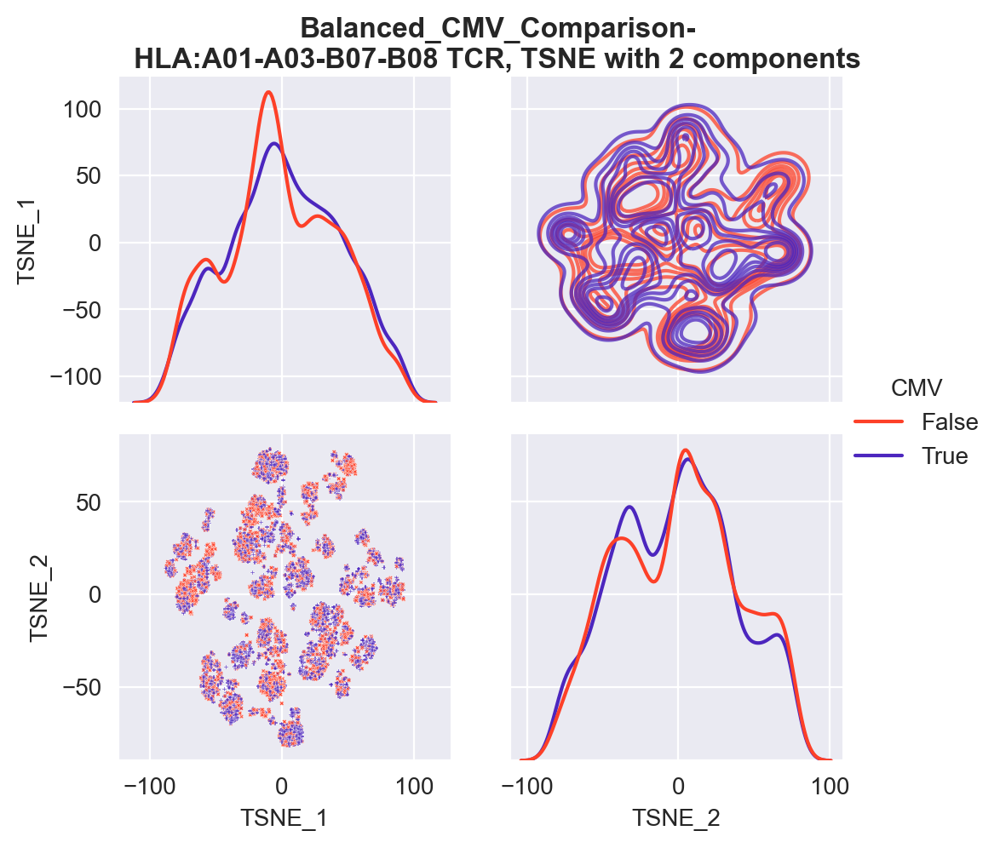

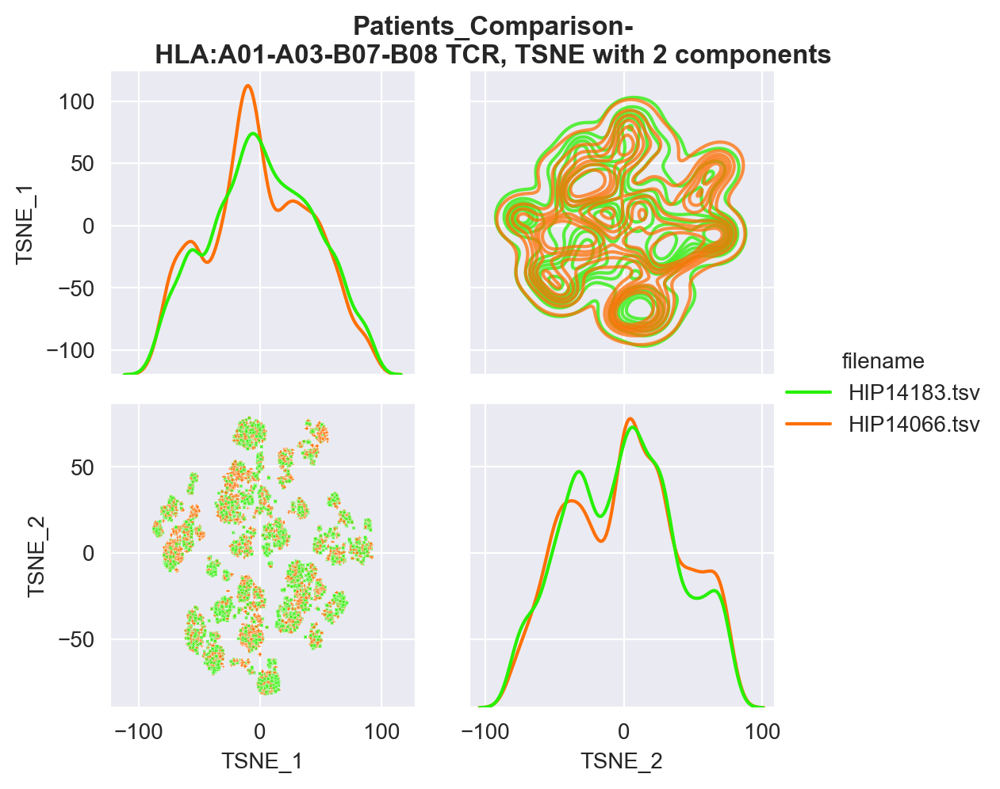

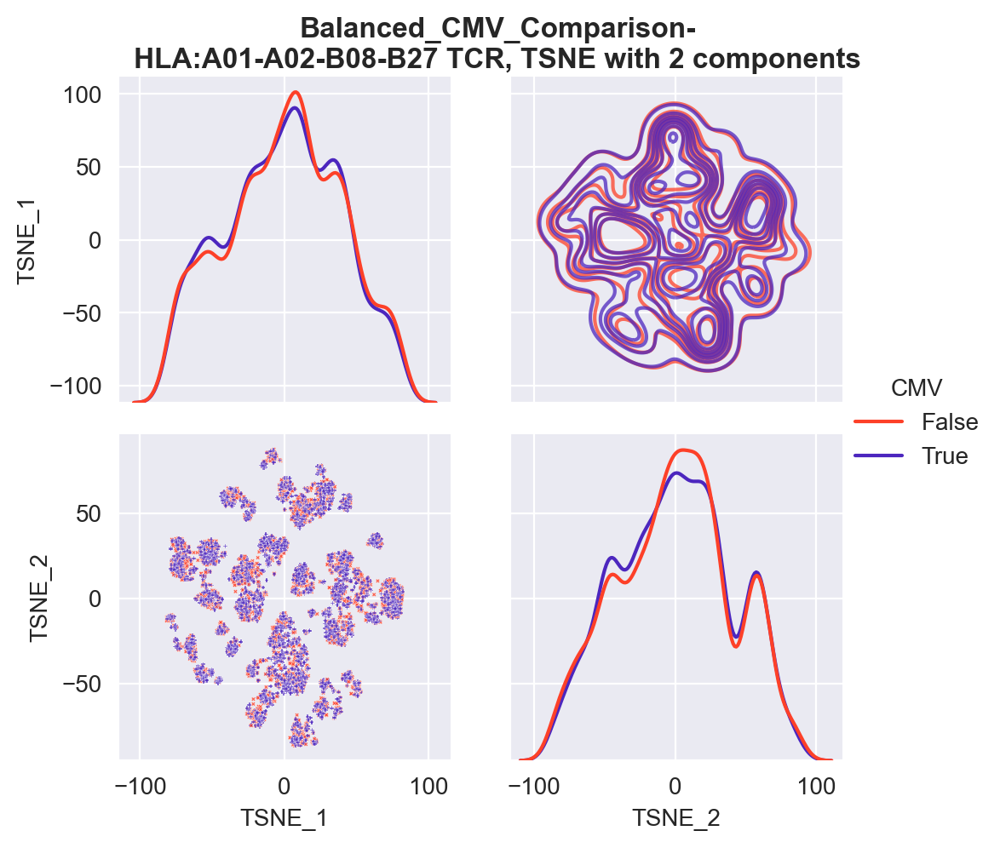

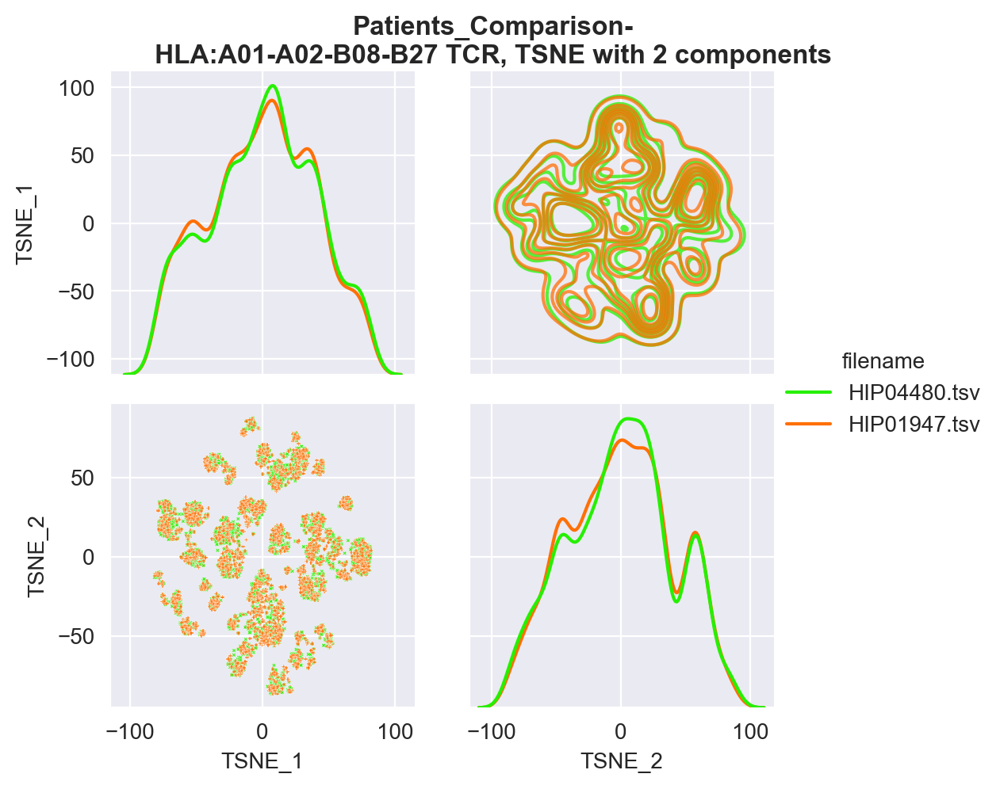

In [205]:
emerson['CMV'] = emerson['true_cmv'].astype(bool)
pal = sns.color_palette('CMRmap_r', n_colors=3)[1], sns.color_palette('CMRmap_r', n_colors=3)[2]
#Shared top10
for c in [fn0, fn1, fn2, fn3, fn4, fn5, fn6]:
    #fns = sample_tags.query('`class`== @c').filename.unique()
    class_ = sample_tags.query('filename in @c')['class'].unique()[0]    
    sub = get_topk(emerson.query('filename in @c and len>10 and len <=23'), 4000,
                   verbose = False)
    tmp = get_tsne(sub, model_reload, positional = False)
    plot_tsne(tmp, hue='CMV', name='Balanced_CMV_Comparison-\nHLA:'+str(class_), 
              comp = True, palette = pal)
    plt.savefig('./tsne/cmv_comparison/comp_'+str(class_)+'_CMV.jpg', dpi = 300)
    
    plot_tsne(tmp, hue='filename', name='Patients_Comparison-\nHLA:'+str(class_), 
              comp = True, palette = 'gist_ncar')
    plt.savefig('./tsne/cmv_comparison/comp_'+str(class_)+'_Patients.jpg', dpi = 300)

### UMAP

	 Getting 2 patients
Length of df 78307


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
52,HIP01255.tsv,Unknown,Male,Unknown,A02,A24,B35,B39,A02-A24-B35-B39
224,HIP08792.tsv,51,Male,Caucasian,A29,A31,B07,B44,A29-A31-B07-B44


Total shared :  1309
	 Getting the top 5000
# Shared in top 5000 seqs : 40
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79790


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
273,HIP10480.tsv,11,Female,Unknown,A03,Unknown,B50,B55,A03-B50-B55
581,HIP14227.tsv,45,Female,Caucasian,A02,A23,B07,B44,A02-A23-B07-B44


Total shared :  1507
	 Getting the top 5000
# Shared in top 5000 seqs : 37
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79838


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
71,HIP01805.tsv,Unknown,Female,Unknown,A01,Unknown,B13,B35,A01-B13-B35
421,HIP13789.tsv,63,Female,Native American or Alaska Native,A01,A02,B08,B62,A01-A02-B08-B62


Total shared :  1232
	 Getting the top 5000
# Shared in top 5000 seqs : 33
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79758


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
287,HIP10814.tsv,Unknown,Male,Unknown,A03,A32,B07,B35,A03-A32-B07-B35
353,HIP13276.tsv,53,Male,Caucasian,A01,A02,B07,B08,A01-A02-B07-B08


Total shared :  1351
	 Getting the top 5000
# Shared in top 5000 seqs : 30
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79738


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
265,HIP10376.tsv,35,Female,Caucasian,A03,A23,B35,B44,A03-A23-B35-B44
512,HIP14048.tsv,Unknown,Female,Unknown,A01,A03,B07,B55,A01-A03-B07-B55


Total shared :  1390
	 Getting the top 5000
# Shared in top 5000 seqs : 60
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79839


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
171,HIP05460.tsv,50,Female,Caucasian,A01,A03,B49,B57,A01-A03-B49-B57
247,HIP09122.tsv,Unknown,Female,Unknown,A11,A26,B48,B75,A11-A26-B48-B75


Total shared :  1081
	 Getting the top 5000
# Shared in top 5000 seqs : 33
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79771


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
113,HIP03381.tsv,42,Female,Caucasian,A02,A24,B44,B51,A02-A24-B44-B51
612,HIP17585.tsv,58,Female,Caucasian,A24,A29,B44,B57,A24-A29-B44-B57


Total shared :  1309
	 Getting the top 5000
# Shared in top 5000 seqs : 46
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79639


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
246,HIP09119.tsv,Unknown,Female,Unknown,A02,A03,B14,B51,A02-A03-B14-B51
354,HIP13284.tsv,11,Male,Caucasian,A01,A68,B08,B55,A01-A68-B08-B55


Total shared :  1126
	 Getting the top 5000
# Shared in top 5000 seqs : 35
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79704


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
289,HIP10817.tsv,26,Male,Caucasian,A02,A03,B60,B62,A02-A03-B60-B62
309,HIP12034.tsv,2,Female,Caucasian,A24,Unknown,B07,B51,A24-B07-B51


Total shared :  1498
	 Getting the top 5000
# Shared in top 5000 seqs : 60
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79774


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
66,HIP01571.tsv,Unknown,Male,Unknown,A01,A02,B51,B63,A01-A02-B51-B63
411,HIP13757.tsv,34,Female,Caucasian,A02,A24,B07,B60,A02-A24-B07-B60


Total shared :  1300
	 Getting the top 5000
# Shared in top 5000 seqs : 34
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.


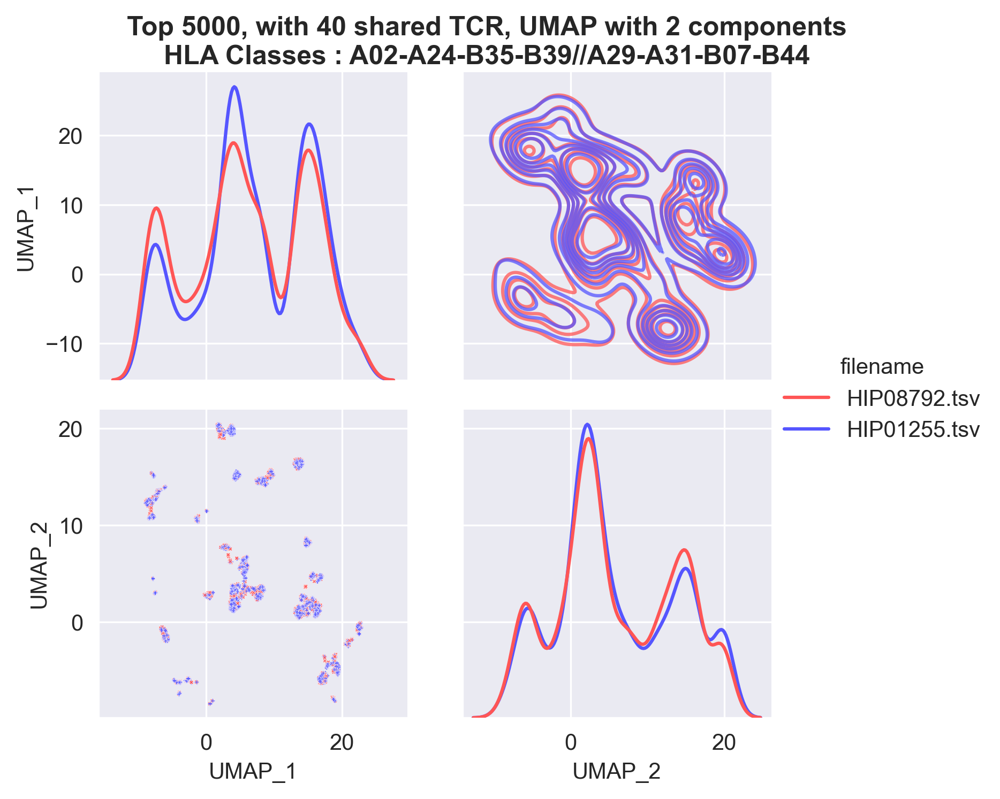

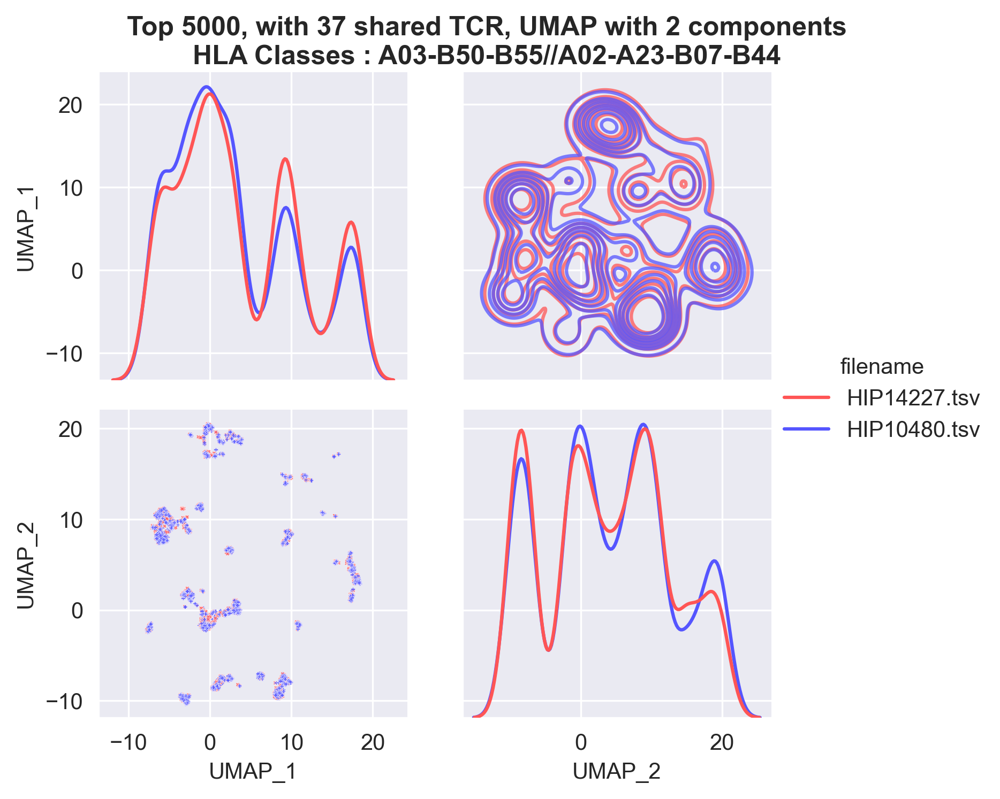

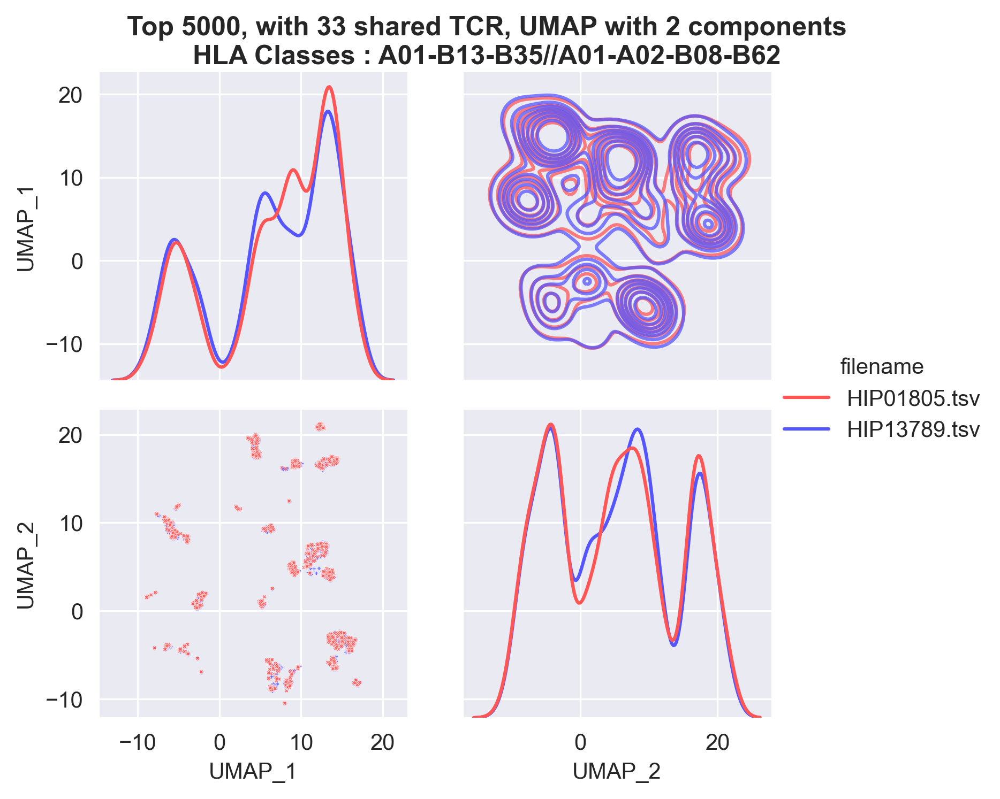

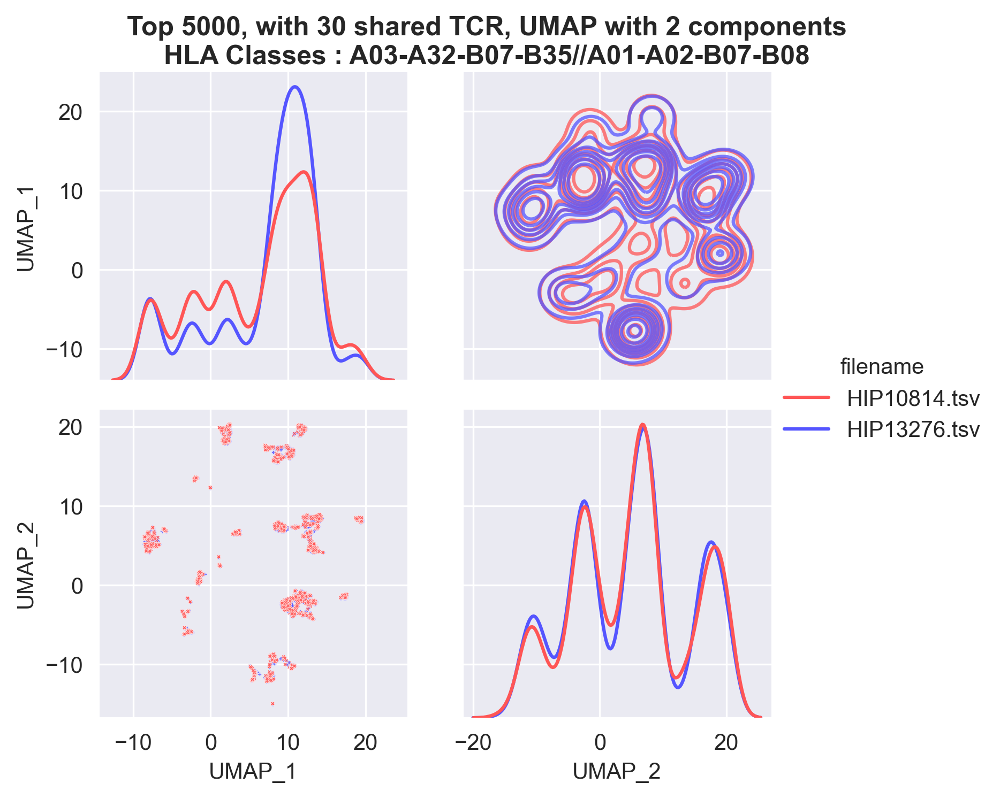

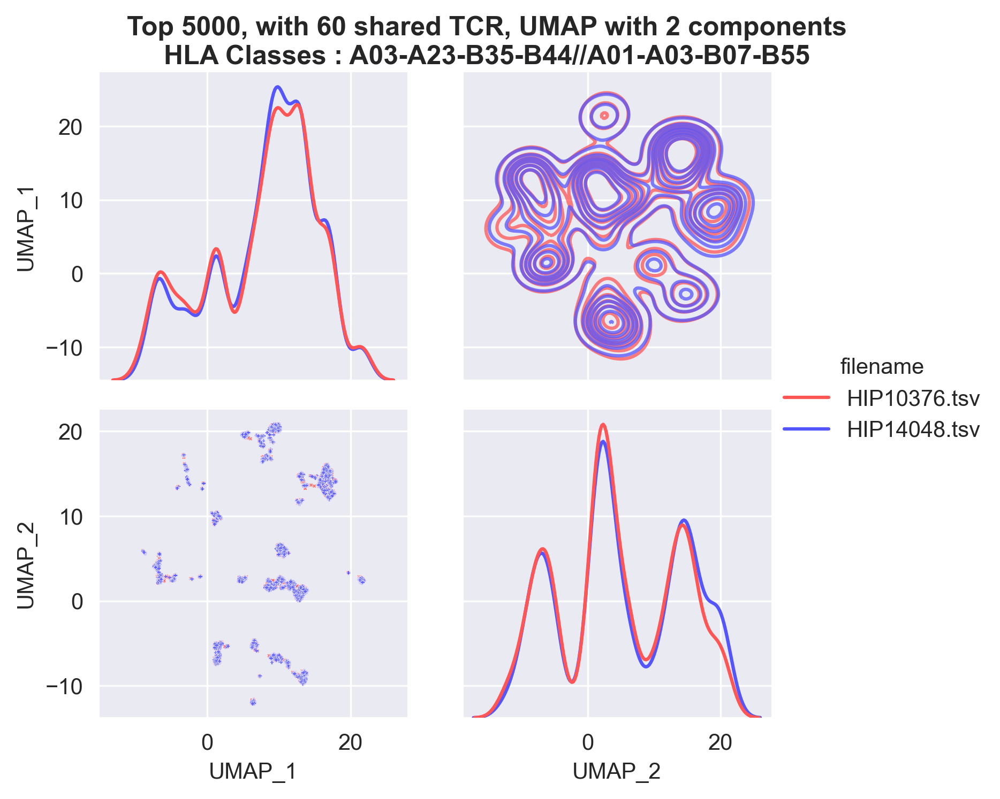

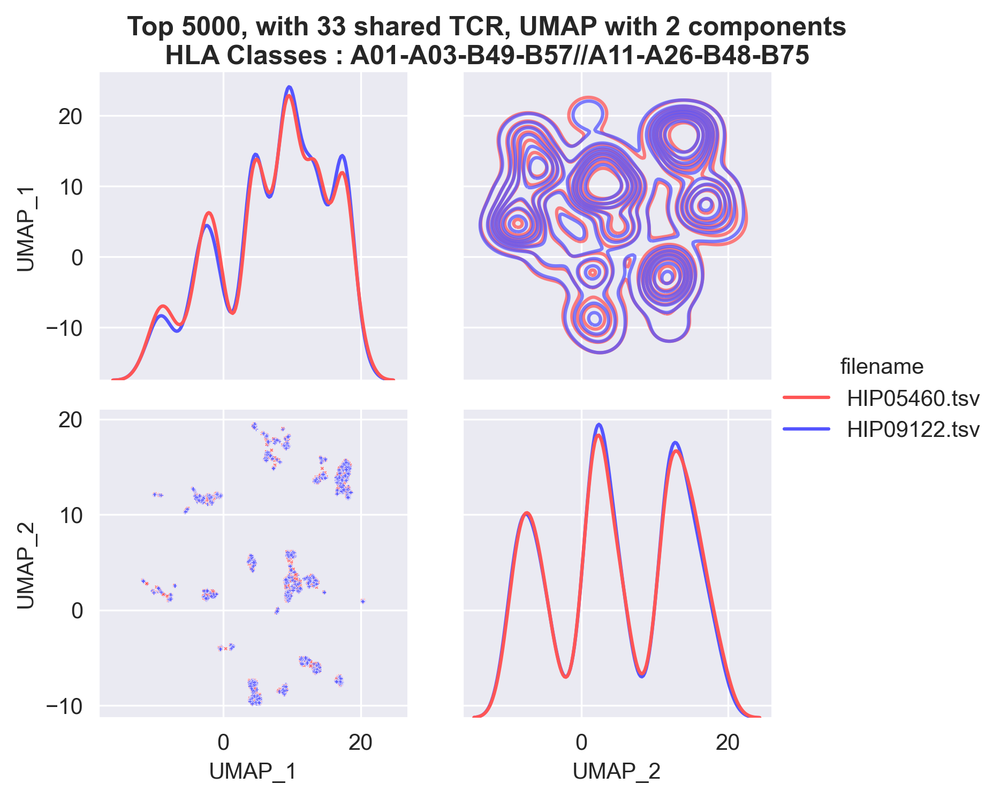

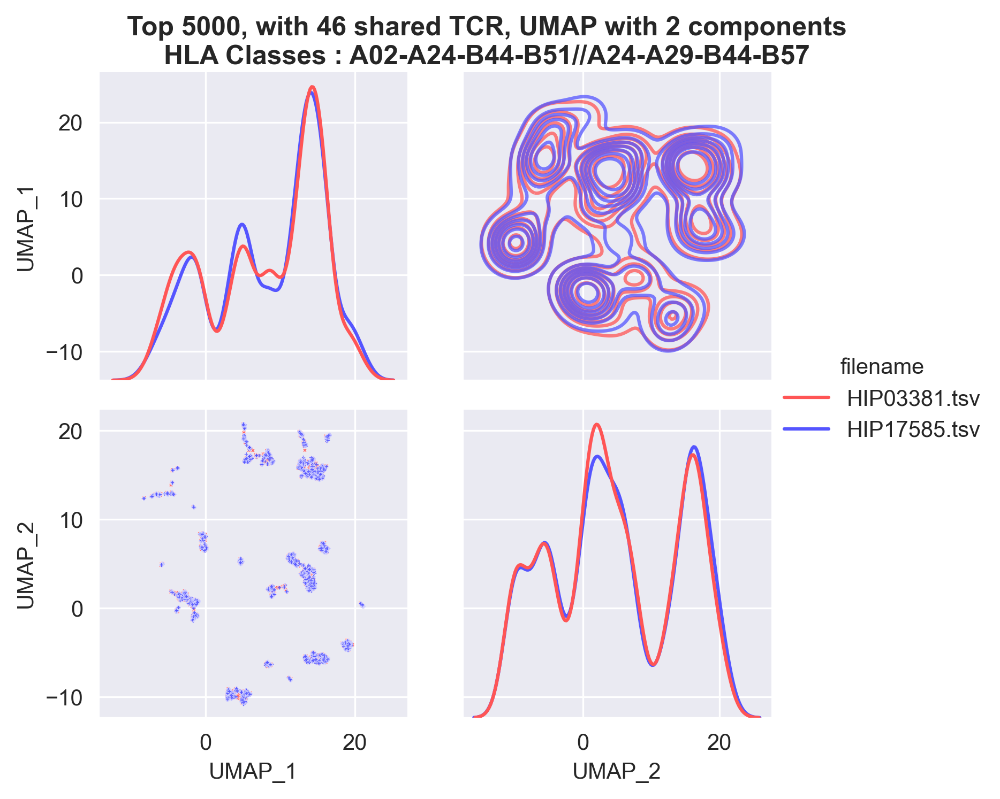

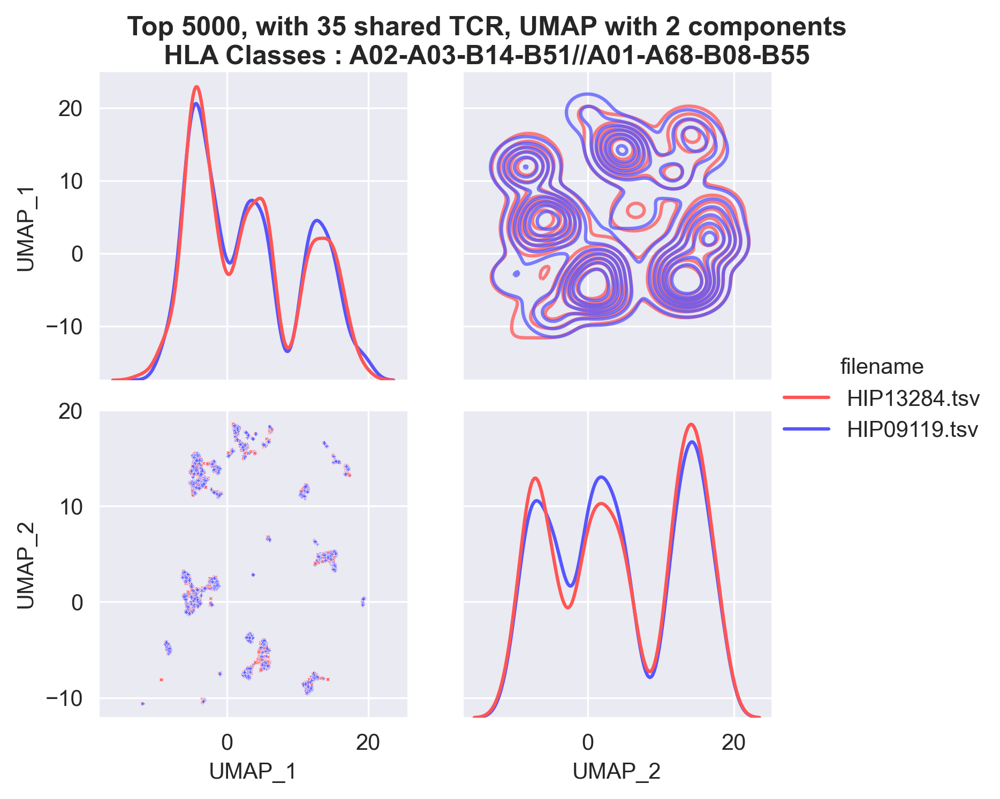

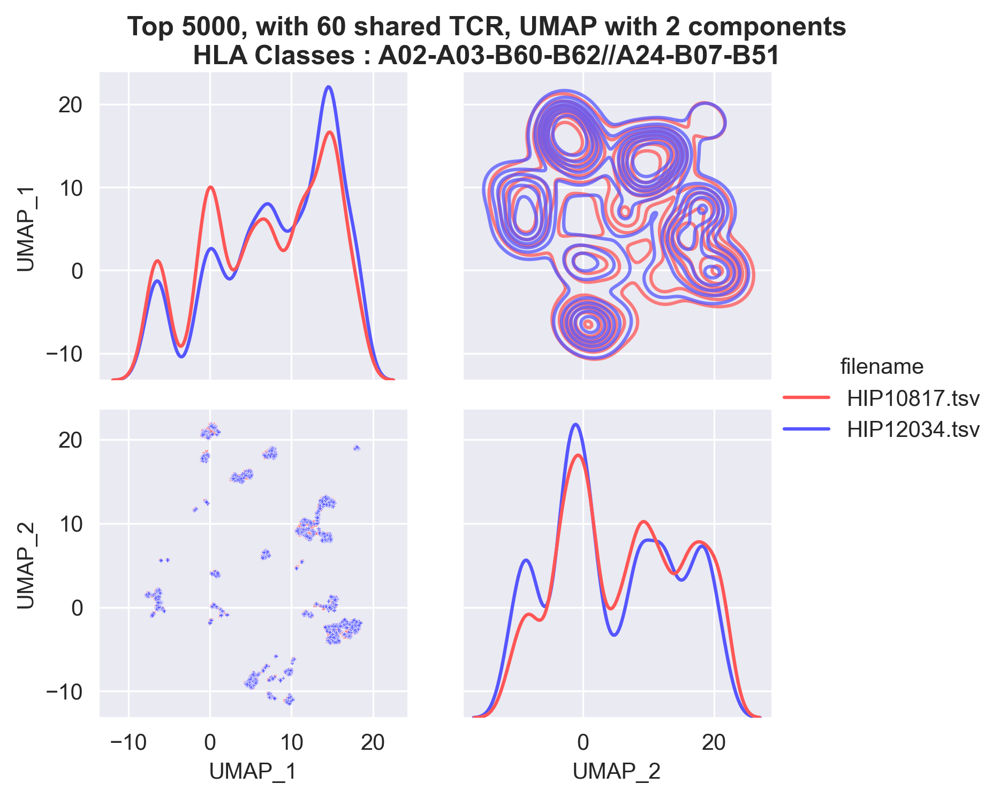

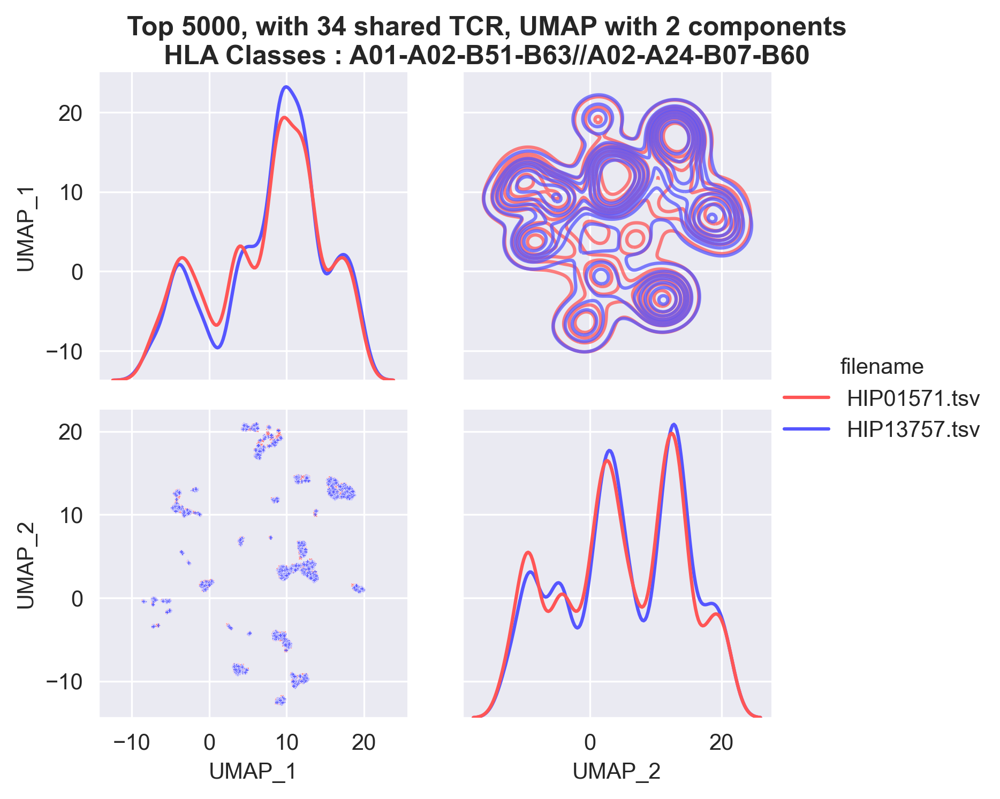

In [50]:
for i in range(10):
    _,_, filenames = pipeline_umap(model_reload, 2, top_k=5000, hue = 'filename', palette='seismic_r')

	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 15000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 15000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 15
	 Onehot-encoding.
	 Embedding 12500 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 12500 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 18
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 14
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 12
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.


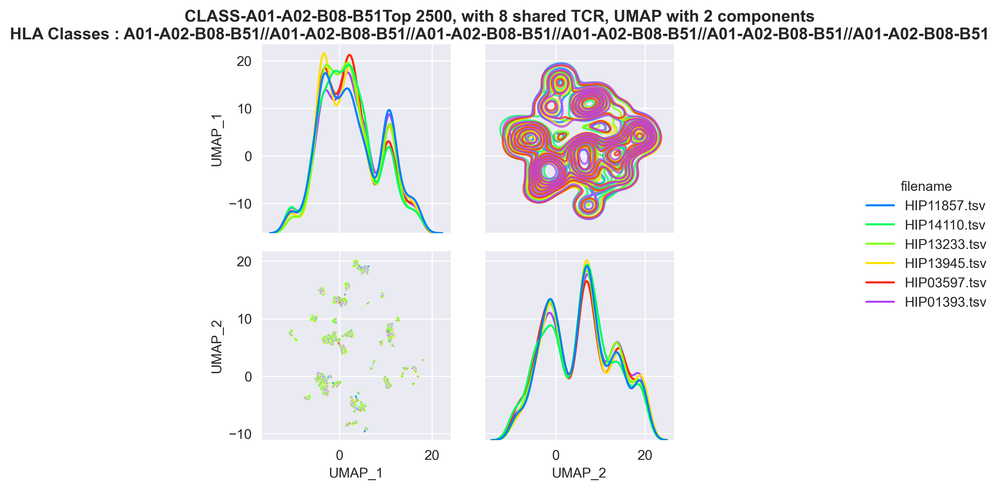

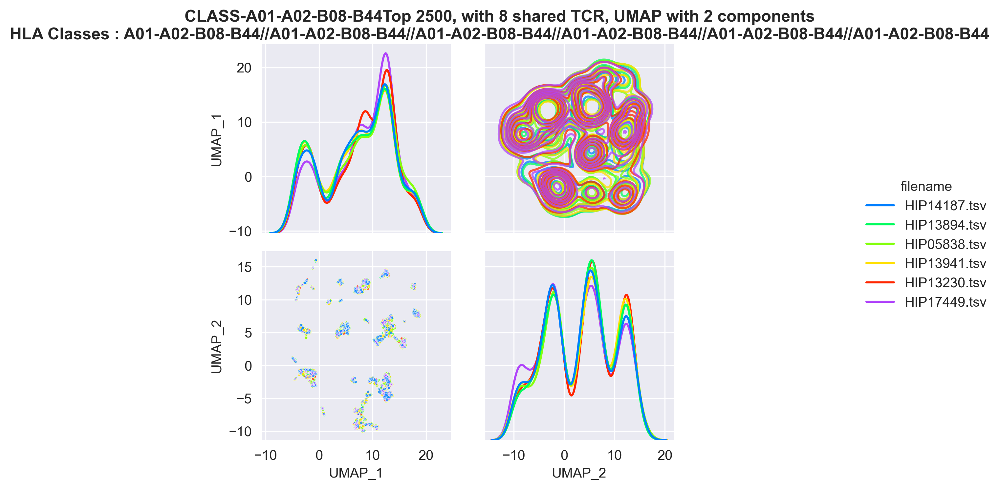

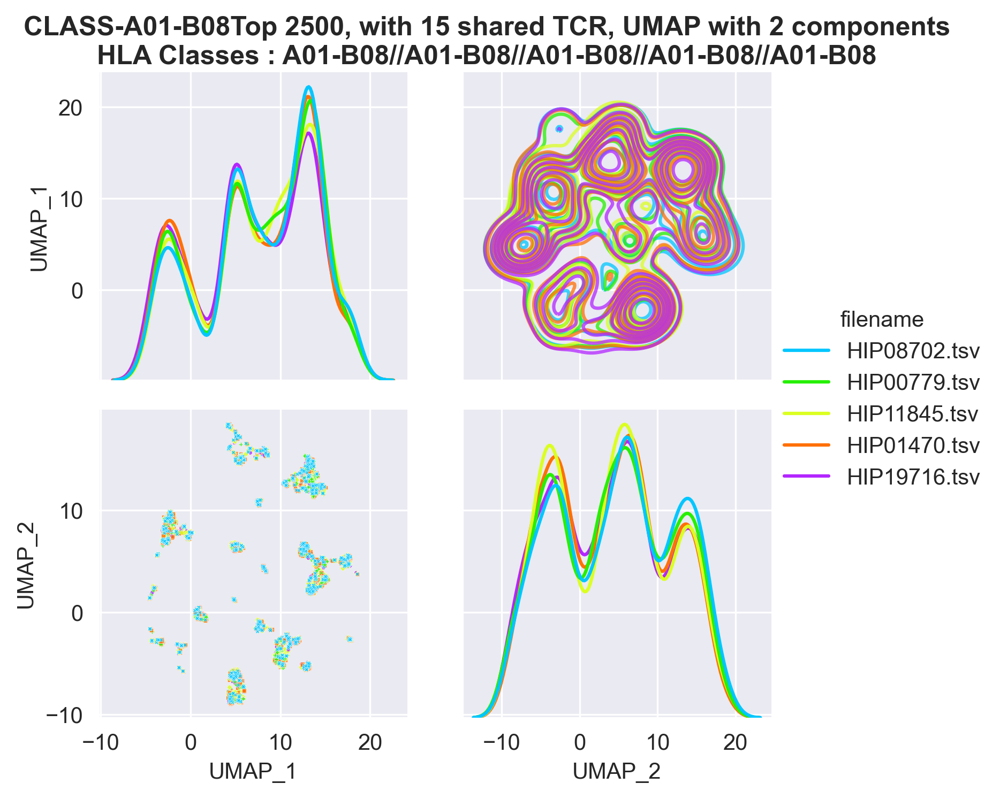

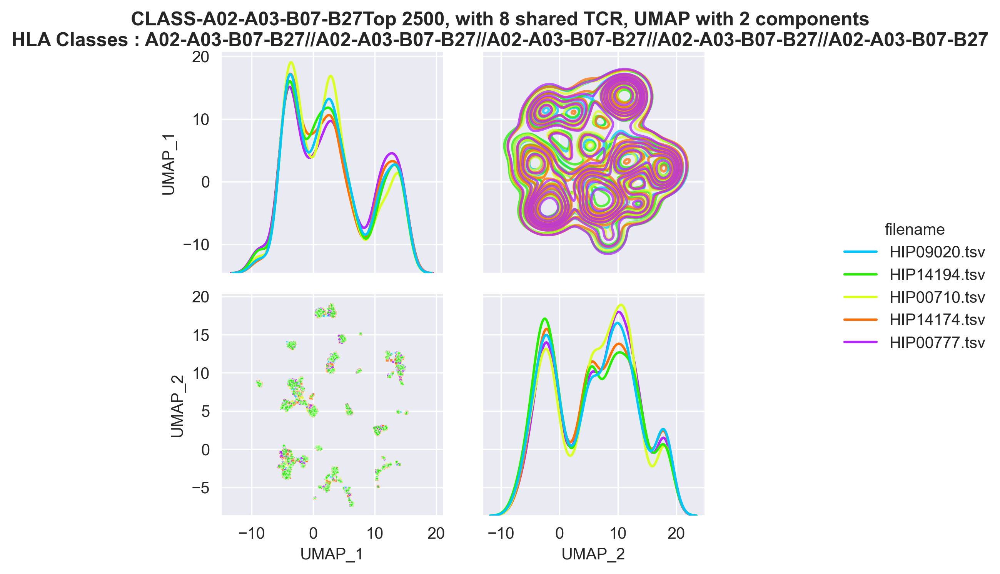

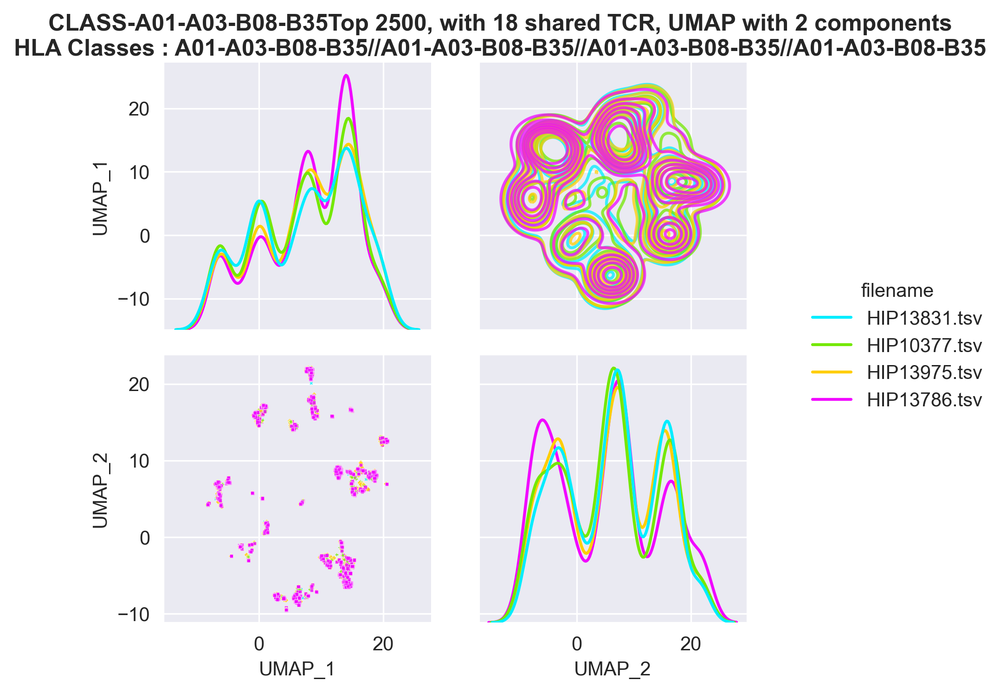

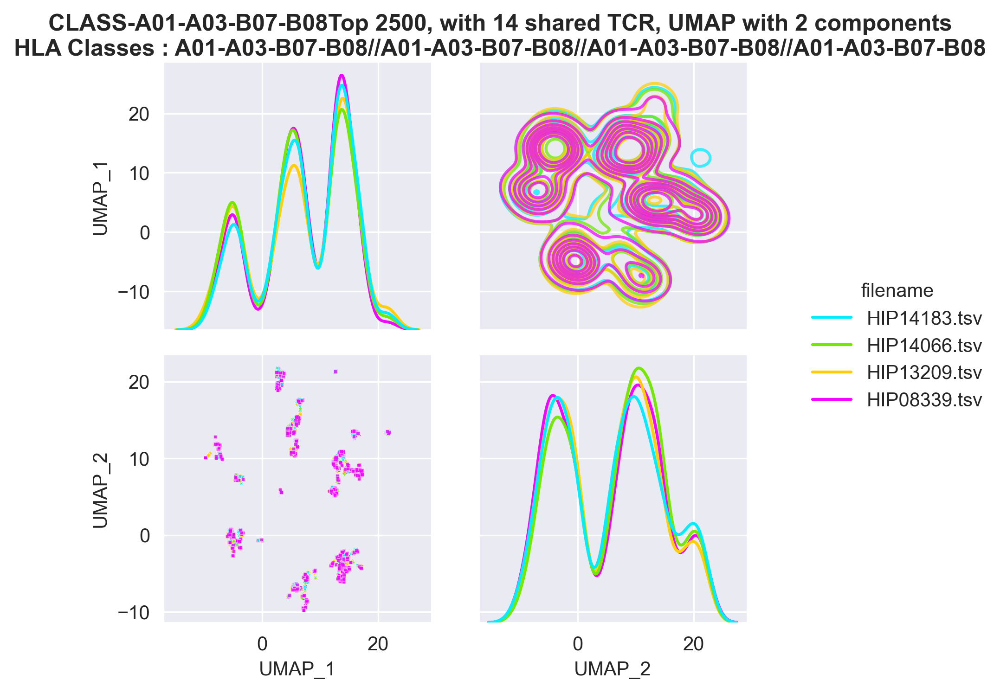

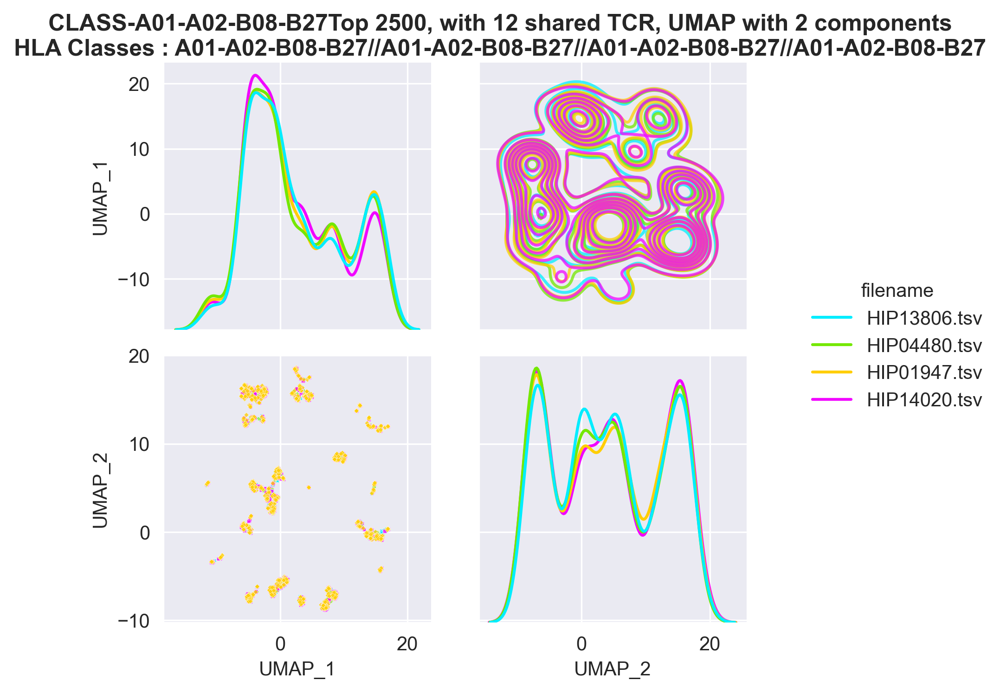

In [56]:
#Shared top10
shared_classes = sample_tags.groupby('class').count().sort_values('filename',ascending=False).head(9).index[:7]
for c in shared_classes:
    fns = sample_tags.query('`class`== @c').filename.unique()
    sub = emerson.query('filename in @fns and len>10 and len <=23')
    _ =pipeline_umap_alt(model_reload, sub, top_k = 2500, 
                    hue = 'filename', name = 'CLASS-'+c,
                   palette = 'gist_ncar')

	 Getting 2 patients
Length of df 56375


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
172,HIP05467.tsv,34,Female,Caucasian,A02,A29,B44,Unknown,A02-A29-B44
424,HIP13800.tsv,66,Male,Caucasian,A03,A68,B07,B08,A03-A68-B07-B08


Total shared :  439
	 Getting the top 5000
# Shared in top 5000 seqs : 25
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 77460


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
2,HIP00594.tsv,21,Male,Caucasian,A02,A32,B07,B61,A02-A32-B07-B61
104,HIP03107.tsv,36,Male,Caucasian,A01,A11,B17,B62,A01-A11-B17-B62


Total shared :  871
	 Getting the top 5000
# Shared in top 5000 seqs : 27
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 78560


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
60,HIP01392.tsv,45,Female,Unknown,A02,A29,B18,B44,A02-A29-B18-B44
183,HIP05578.tsv,29,Female,Caucasian,A03,A30,B14,B51,A03-A30-B14-B51


Total shared :  1267
	 Getting the top 5000
# Shared in top 5000 seqs : 40
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 65267


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
65,HIP01501.tsv,Unknown,Male,Unknown,A01,A32,B08,B60,A01-A32-B08-B60
428,HIP13814.tsv,41,Female,Caucasian,A01,A03,B07,B57,A01-A03-B07-B57


Total shared :  606
	 Getting the top 5000
# Shared in top 5000 seqs : 21
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79707


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
201,HIP08076.tsv,Unknown,Female,Unknown,A23,A32,B35,B49,A23-A32-B35-B49
237,HIP09022.tsv,47,Female,Caucasian,A01,A03,B08,B62,A01-A03-B08-B62


Total shared :  1226
	 Getting the top 5000
# Shared in top 5000 seqs : 33
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.


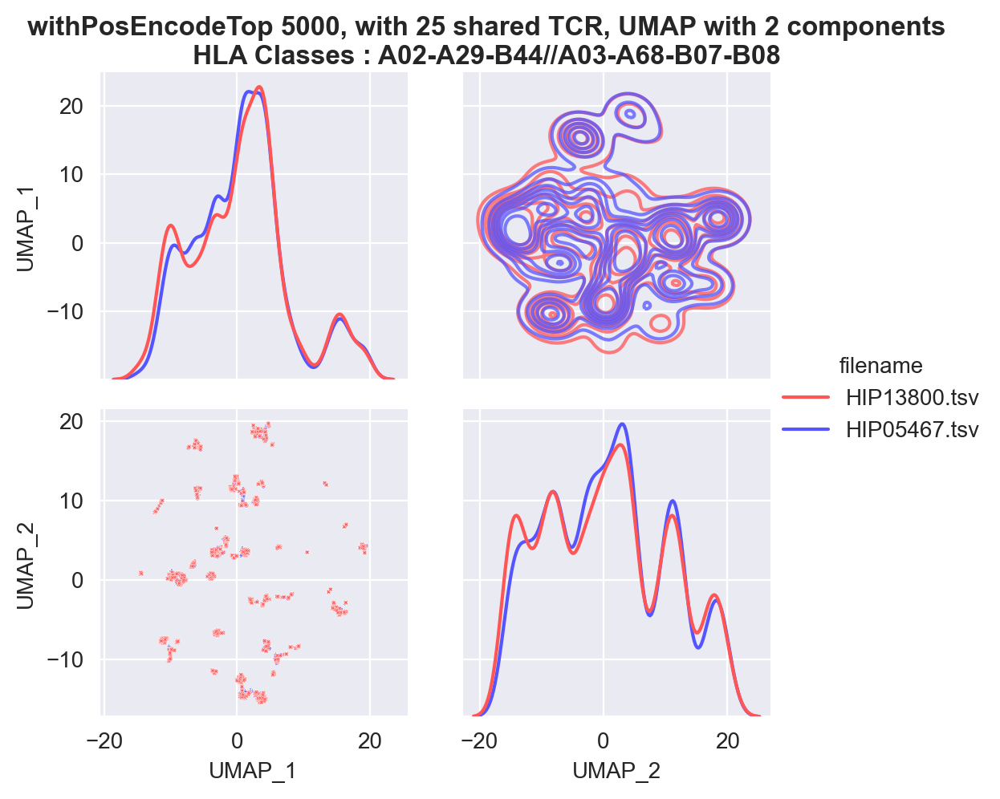

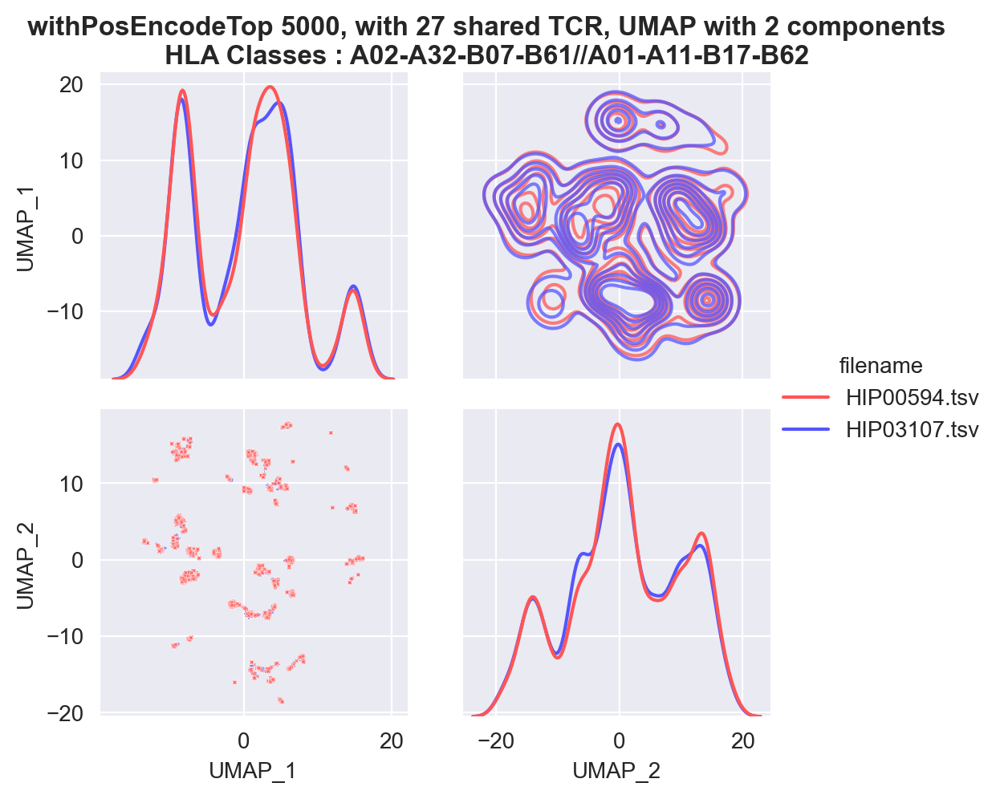

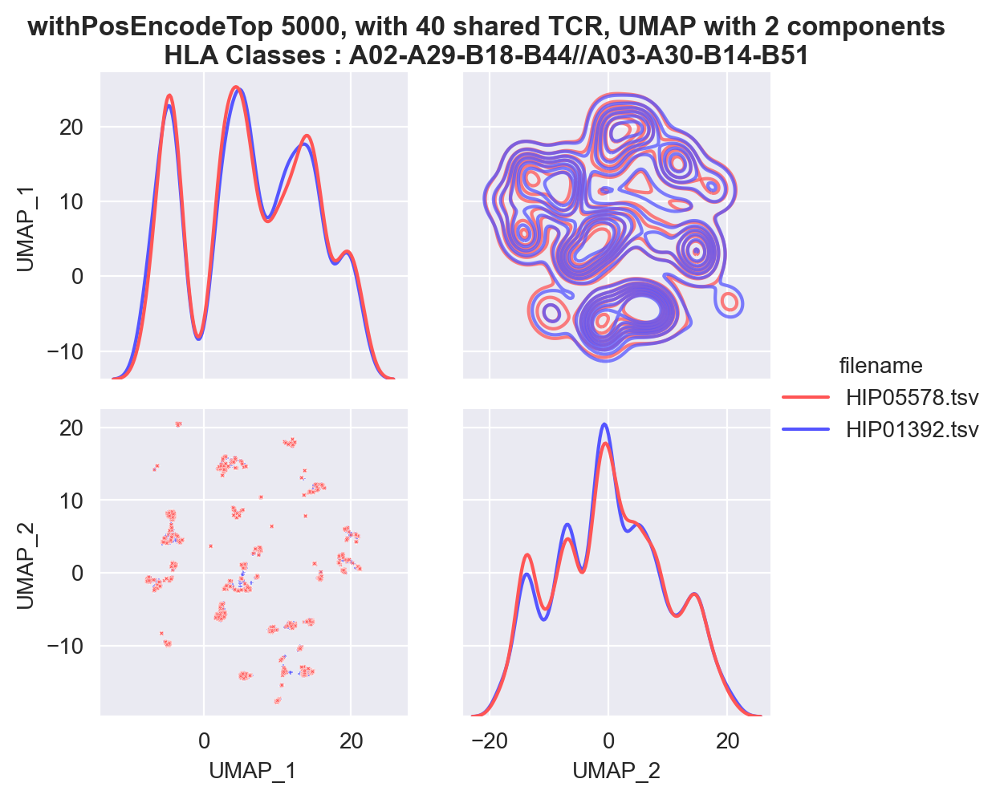

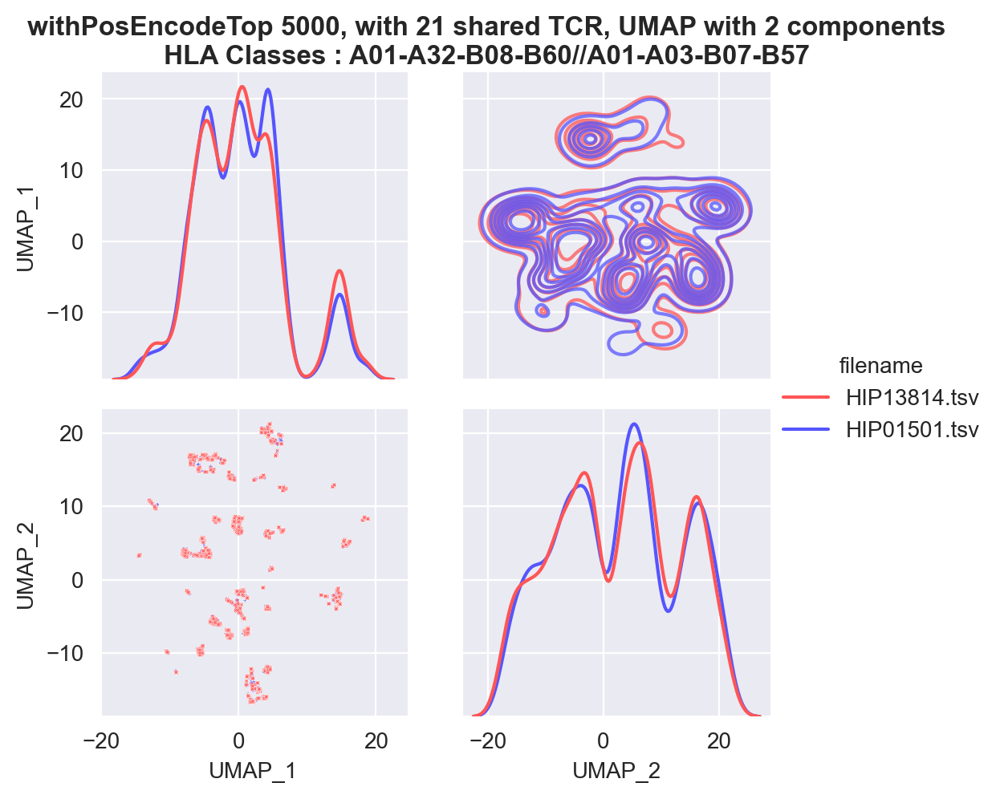

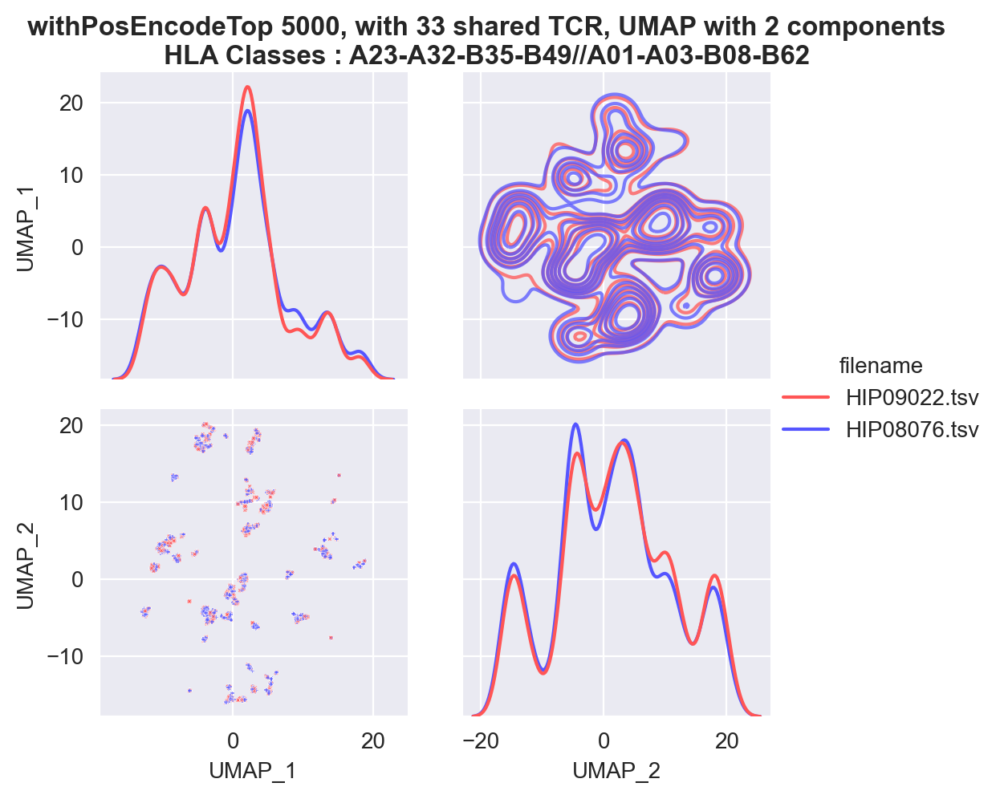

In [107]:
for i in range(5):
    _,_, filenames = pipeline_umap(model_pos, 2, top_k=5000, name = 'withPosEncode', 
                                   positional = True,
                                   hue = 'filename', palette='seismic_r')

In [81]:
#Both female, both exact same HLA, but different CMV status
sample_tags.query('`class`.str.startswith("A01-A02-B08-B27")')[0:2]

,filename,pred_cmv,true_cmv,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class,dataset
78,HIP01947.tsv,1,1,Unknown,Female,Unknown,A01,A02,B08,B27,A01-A02-B08-B27,train
142,HIP04480.tsv,0,0,33,Female,Unknown,A01,A02,B08,B27,A01-A02-B08-B27,train


In [97]:
#fn=['HIP16867.tsv', 'HIP05665.tsv']
#SAME HLA; diff CMV
fn = ['HIP01947.tsv', 'HIP04480.tsv']
#topk = get_topk(emerson.query('filename in @fn'),30000)[0].query('len>10 and len<=23')
ump = get_umap(emerson.query('filename in @fn and len > 10 and len <= 23'), model_reload)
tsn = get_tsne(emerson.query('filename in @fn and len > 10 and len <= 23'), model_reload)

	 Onehot-encoding.
	 Embedding 79592 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Onehot-encoding.
	 Embedding 79592 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


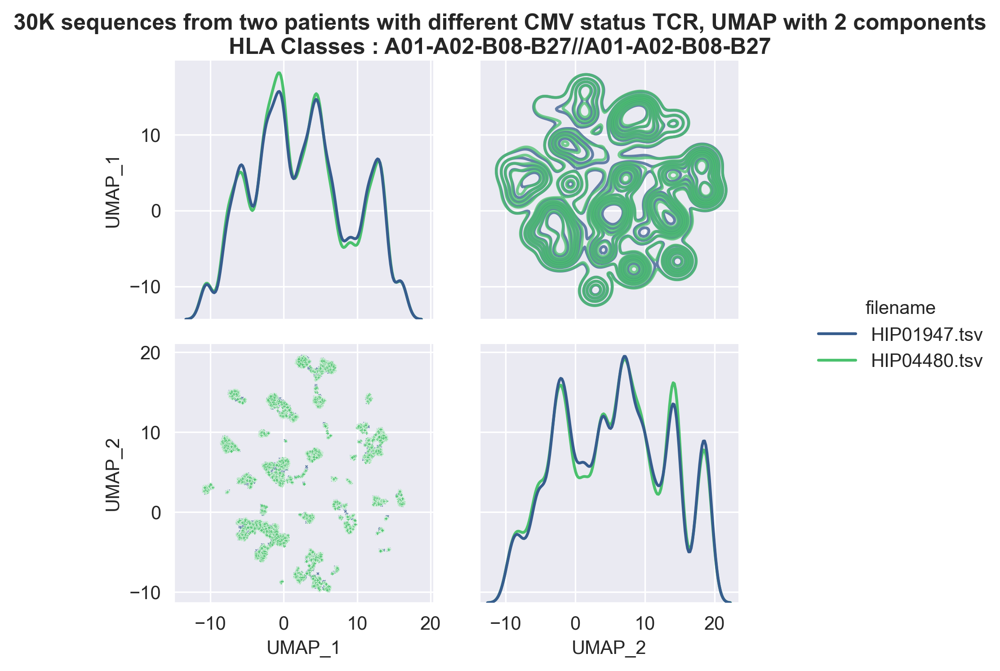

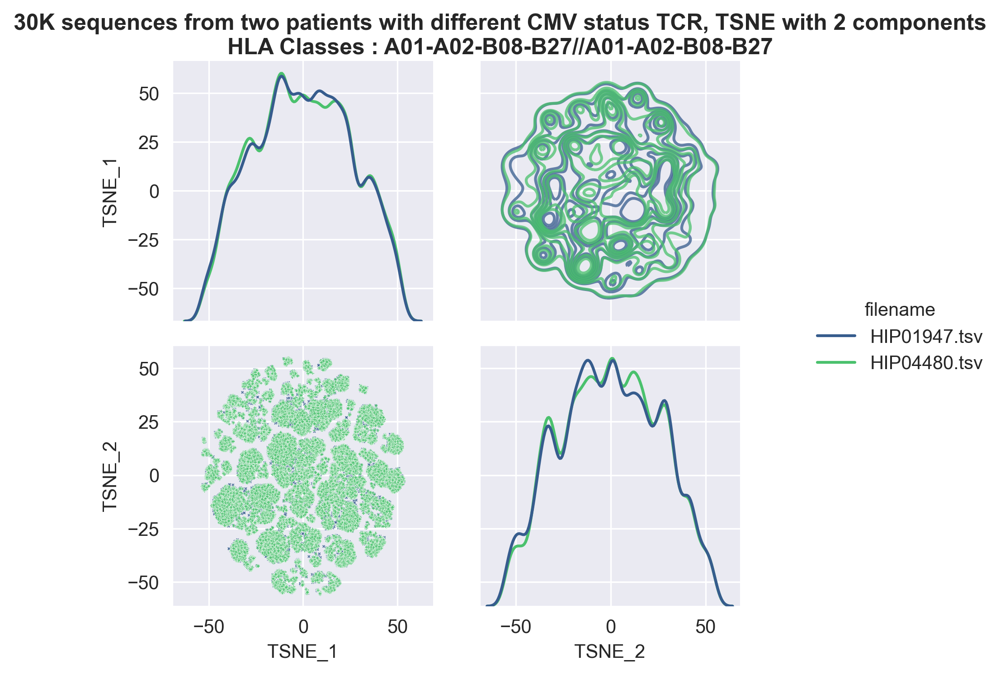

In [99]:
pal = [sns.color_palette('viridis_r',n_colors=6)[-2], sns.color_palette('viridis_r',n_colors=6)[1]]
plot_umap(ump, hue='filename', palette = pal,
          name = '30K sequences from two patients with different CMV status')
plot_tsne(tsn, hue='filename', palette = pal,
          name = '30K sequences from two patients with different CMV status')

### DeepCAT dataset

In [153]:
normal = pd.read_csv('./normal.txt', header=None)
normal['type'] = 'normal'
tumor = pd.read_csv('./tumor.txt', header=None)
tumor['type'] = 'tumor'

df = normal.append(tumor)

In [154]:
df = df.rename(columns={0:'amino_acid'}).query('amino_acid.str.len() > 10 and amino_acid.str.len() <= 23')
df = get_reduc(df, model_reload, reduc = 'umap'.upper())
df = get_reduc(df, model_reload, reduc = 'tsne'.upper())

	 Onehot-encoding.
	 Embedding 99700 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Onehot-encoding.
	 Embedding 99700 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


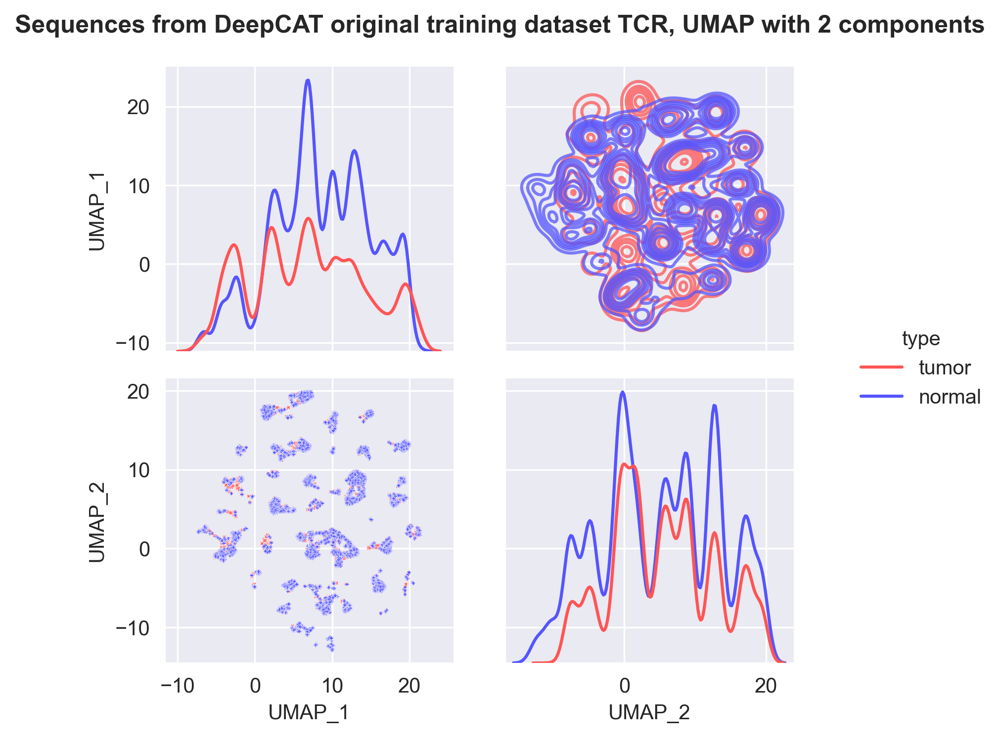

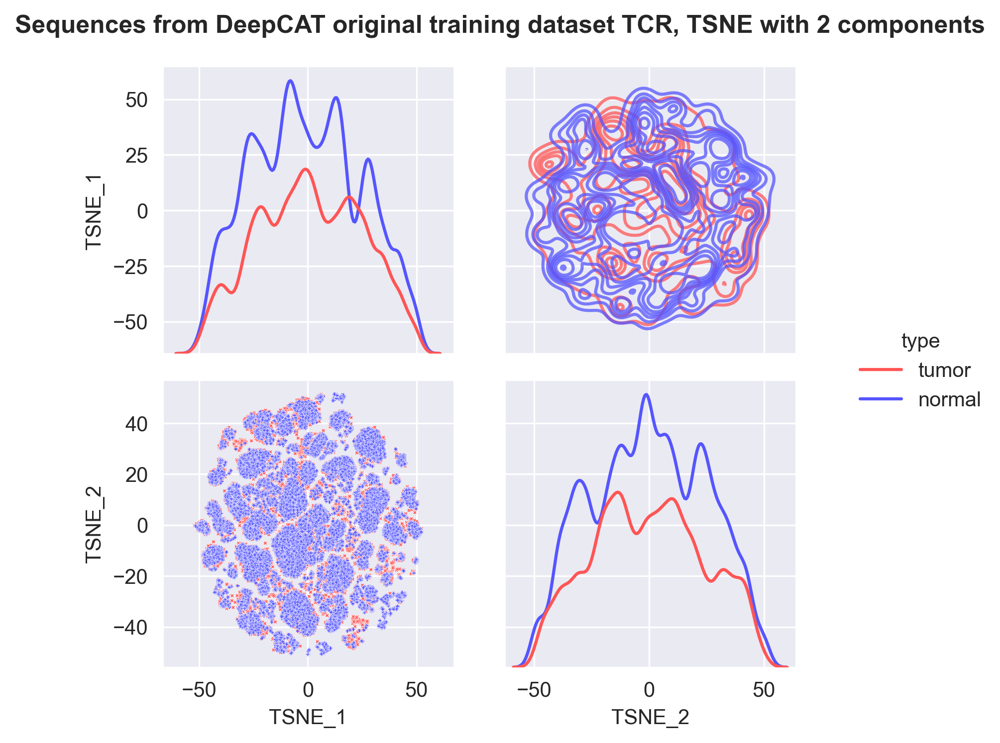

In [158]:
plot_reduc(df.sort_values('type',ascending=False), hue='type', reduc='UMAP', palette = 'seismic_r',
          name = 'Sequences from DeepCAT original training dataset')
plt.savefig('../../../meetings/presentation_results/210322_update/deepcat/deepcat_UMAP.jpg', dpi=300)
plot_reduc(df.sort_values('type',ascending=False), hue='type', reduc='TSNE', palette = 'seismic_r',
          name = 'Sequences from DeepCAT original training dataset')
plt.savefig('../../../meetings/presentation_results/210322_update/deepcat/deepcat_TSNE.jpg', dpi=300)


### Masking

In [132]:
#Redoing a single TSNE for all to make it deterministic
fns = ['HIP13992.tsv', 'HIP13986.tsv']
sub1, shared = get_topk(mask_seq(emerson.query('filename in @fns')), 5000) #Masking V/J

sub2 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_vj':'amino_acid'})
sub2['masked'] = 'VJ'
sub3 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_centre':'amino_acid'})
sub3['masked'] = 'centre'
sub1['masked'] = 'none'
df = pd.concat([sub1,sub2,sub3], ignore_index=True).drop(columns=['masked_vj','masked_centre']).query('len > 10 and len <=23')
df = get_reduc(df, model_reload, reduc='TSNE')
df = get_reduc(df, model_reload, reduc='UMAP')

	 Getting the top 5000
# Shared in top 5000 seqs : 31
	 Onehot-encoding.
	 Embedding 29907 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Onehot-encoding.
	 Embedding 29907 sequences.
	 Fitting UMAP.
	 Waiting on plotting.


In [ ]:
for reduc in ['TSNE','UMAP']:
    for masked in df.masked.unique():
        for hue, pal in zip(['filename','v_family'],['seismic_r','hsv']):
            plot_reduc(df.query('masked==@masked'), hue = hue, 
                       reduc = reduc,
                       name = f'{reduc} of TCR_sequences with {masked} part masked',
                       palette = pal)
            plt.savefig(f'../../../meetings/presentation_results/210322_update/mask/top_5k_{reduc}_{masked}_{hue}.jpg', dpi = 300)

In [161]:
def mask_pipeline(fns, topk):
    #Redoing a single TSNE for all to make it deterministic
    sub1, shared = get_topk(mask_seq(emerson.query('filename in @fns')), topk) #Masking V/J
    
    sub2 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_vj':'amino_acid'})
    sub2['masked'] = 'VJ'
    sub3 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_centre':'amino_acid'})
    sub3['masked'] = 'centre'
    sub1['masked'] = 'none'
    df = pd.concat([sub1,sub2,sub3], ignore_index=True).drop(columns=['masked_vj','masked_centre']).query('len > 10 and len <=23')
    df = get_reduc(df, model_reload, reduc='TSNE')
    #df = get_reduc(df, model_reload, reduc='UMAP')
    return df

In [187]:
fxs = ['HIP14187.tsv','HIP13894.tsv','HIP05838.tsv','HIP13941.tsv','HIP13230.tsv','HIP17449.tsv']
sample_tags.query('filename in @fxs')

,filename,pred_cmv,true_cmv,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class,dataset
192,HIP05838.tsv,0,0,36,Female,Caucasian,A01,A02,B08,B44,A01-A02-B08-B44,train
344,HIP13230.tsv,1,1,46,Female,Caucasian,A01,A02,B08,B44,A01-A02-B08-B44,train
448,HIP13894.tsv,1,1,46,Female,Caucasian,A01,A02,B08,B44,A01-A02-B08-B44,train
465,HIP13941.tsv,0,0,41,Female,Unknown,A01,A02,B08,B44,A01-A02-B08-B44,test
565,HIP14187.tsv,1,1,43,Female,Caucasian,A01,A02,B08,B44,A01-A02-B08-B44,train
607,HIP17449.tsv,0,0,Unknown,Male,Caucasian,A01,A02,B08,B44,A01-A02-B08-B44,train


In [163]:
same_HLA = mask_pipeline(fxs, 2000)

	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 44784 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


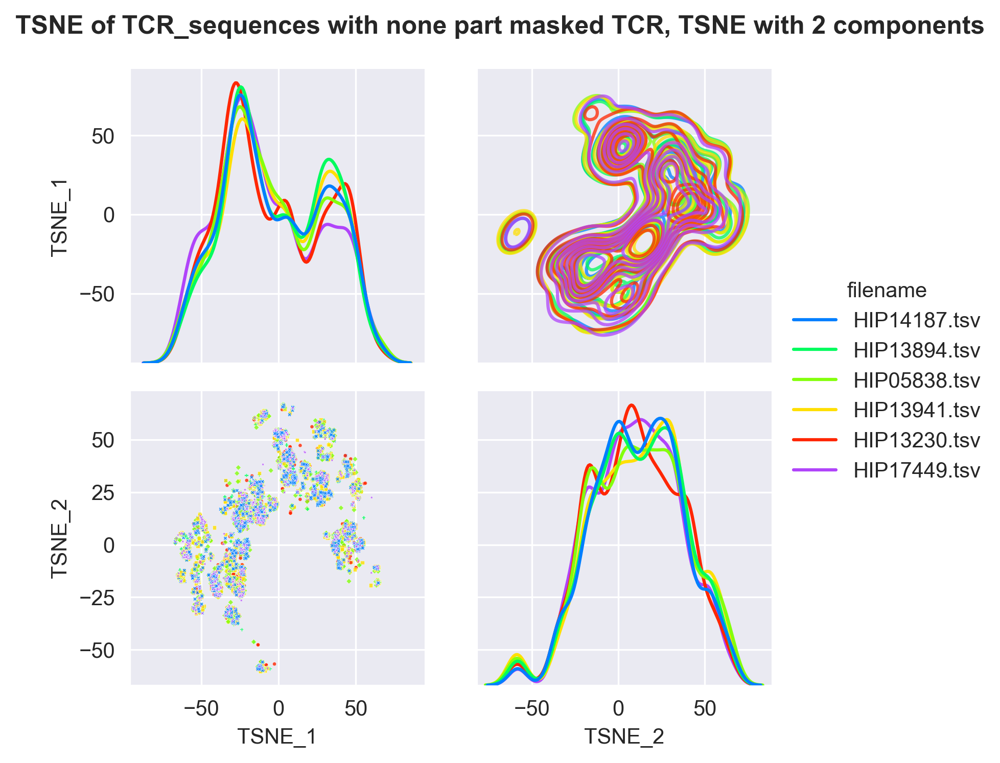

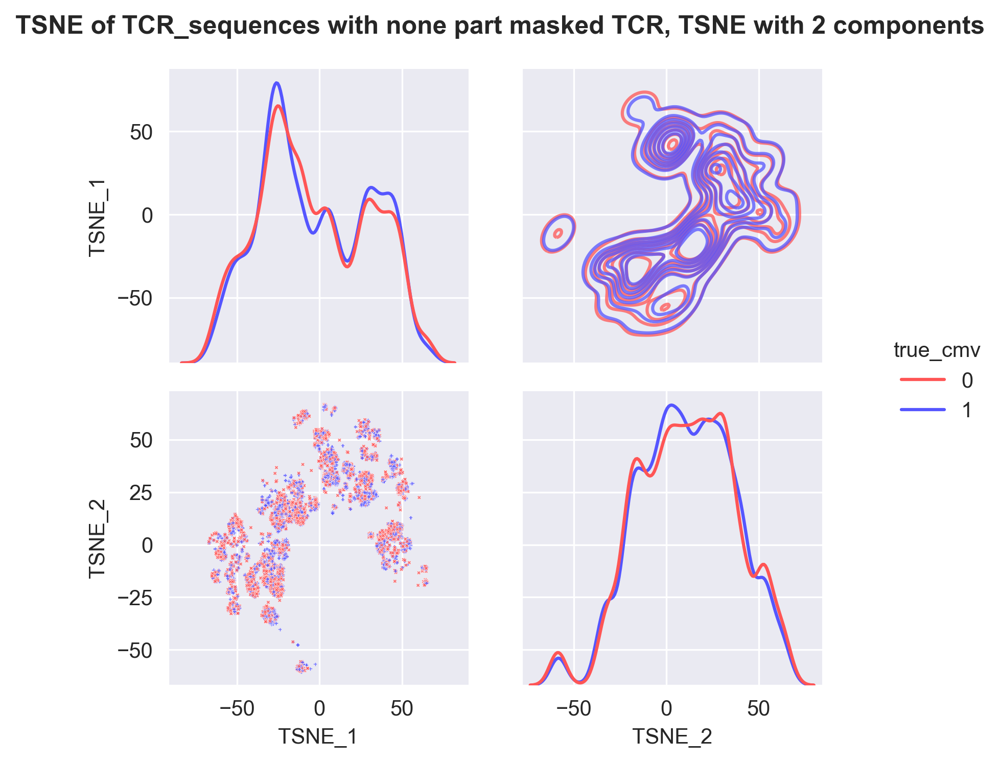

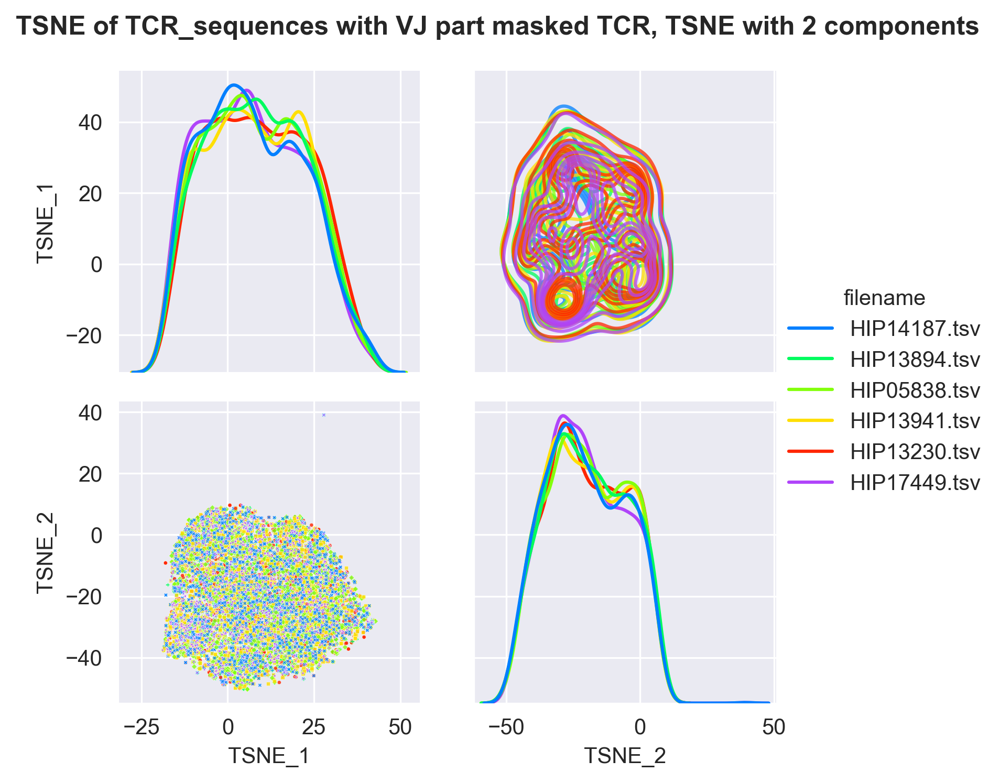

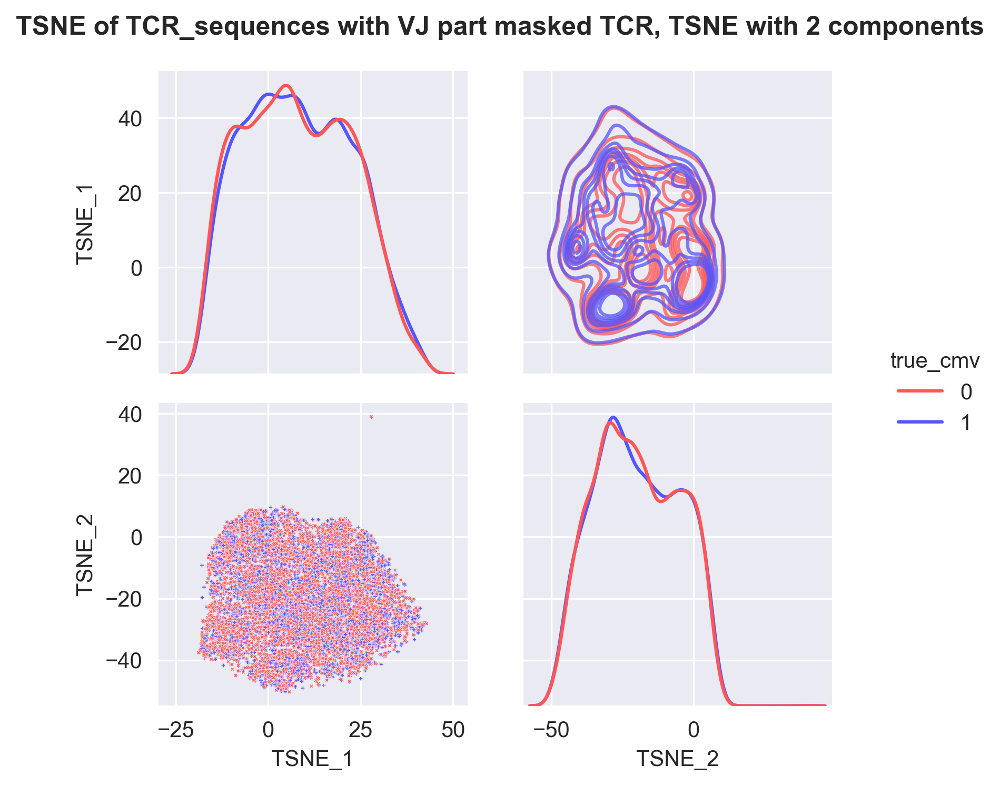

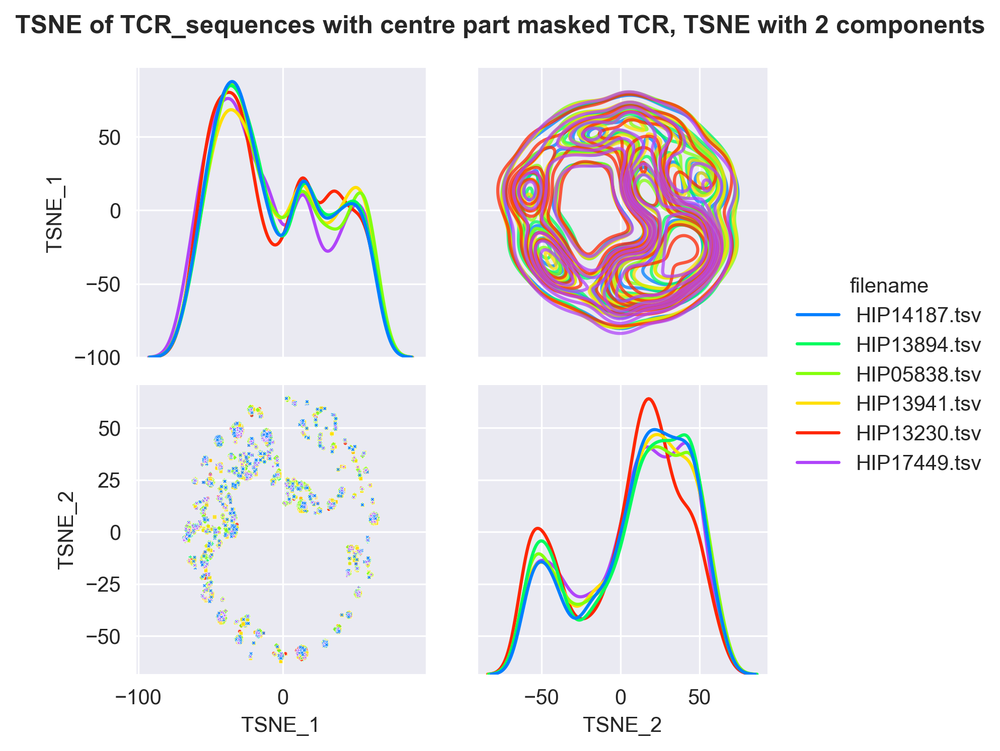

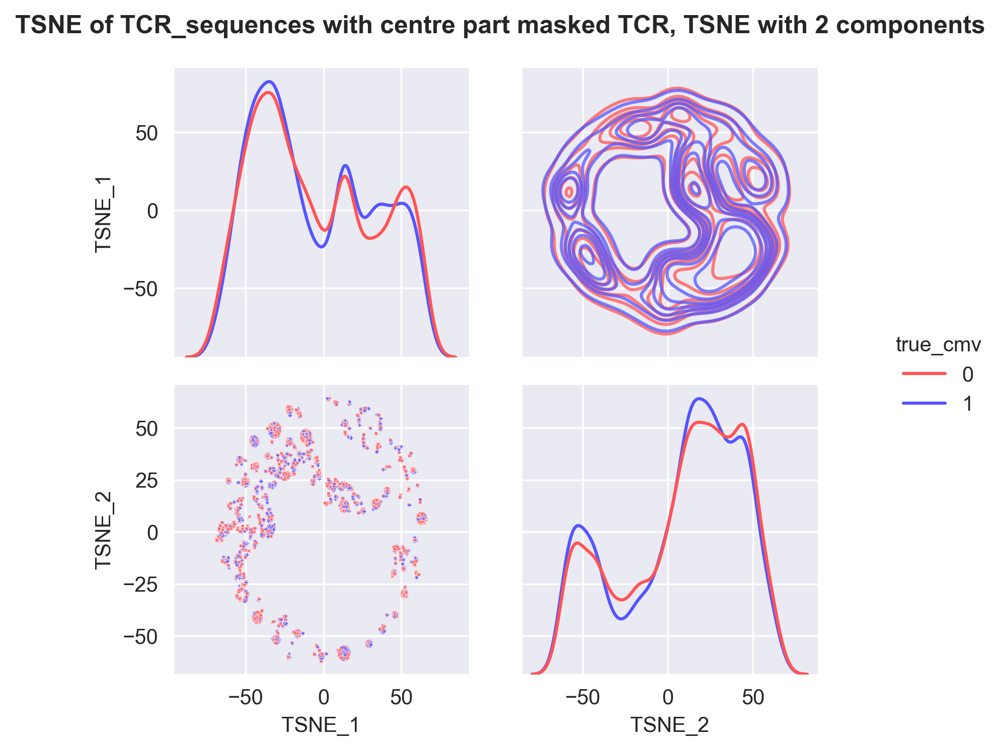

In [164]:
for reduc in ['TSNE']:
    for masked in same_HLA.masked.unique():
        for hue, pal in zip(['filename','true_cmv'],['gist_ncar','seismic_r']):
            plot_reduc(same_HLA.query('masked==@masked'), hue = hue, 
                       reduc = reduc,
                       name = f'{reduc} of TCR_sequences with {masked} part masked',
                       palette = pal)
            plt.savefig(f'../../../meetings/presentation_results/210322_update/mask/same_HLA/cmv_top_5k_{reduc}_{masked}_{hue}.jpg', dpi = 300)

	 Getting the top 3000
# Shared in top 3000 seqs : 7
	 Onehot-encoding.
	 Embedding 6000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


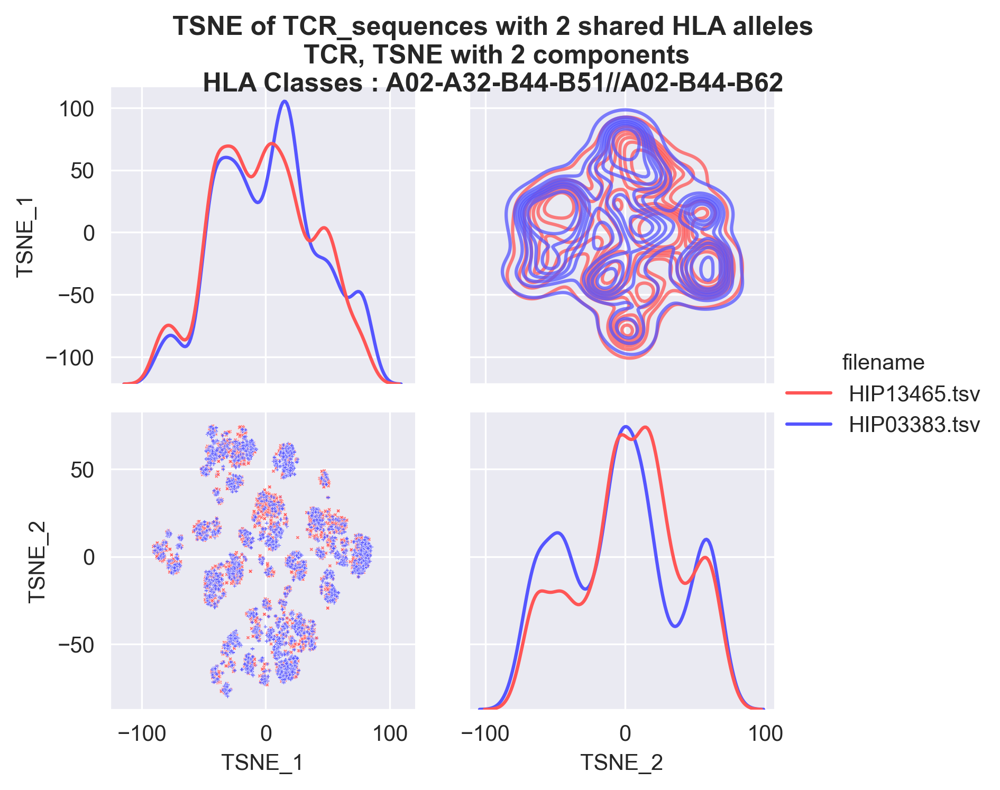

In [184]:
fns = ['HIP13465.tsv', 'HIP03383.tsv']
tmp = get_reduc(get_topk(emerson.query('filename in @fns and len>10 and len <=23'), 3000)[0], model_reload, reduc = 'TSNE')
masked = 'none'
plot_reduc(tmp, hue = 'filename', 
           reduc = 'TSNE',
           name = f'{reduc} of TCR_sequences with 2 shared HLA alleles\n',
           palette = 'seismic_r', comp=False)
plt.savefig(f'../../../meetings/presentation_results/210322_update/cmv_top_3k_{reduc}_{masked}_{hue}.jpg', dpi = 300)

In [179]:
fns = ['HIP09159.tsv', 'HIP14202.tsv']
#fns = ['HIP13465.tsv', 'HIP03383.tsv']
tmp = get_reduc(get_topk(emerson.query('filename in @fns and len>10 and len <=23'), 3000)[0], model_reload, reduc = 'TSNE')
masked = 'none'

	 Getting the top 3000
# Shared in top 3000 seqs : 10
	 Onehot-encoding.
	 Embedding 6000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


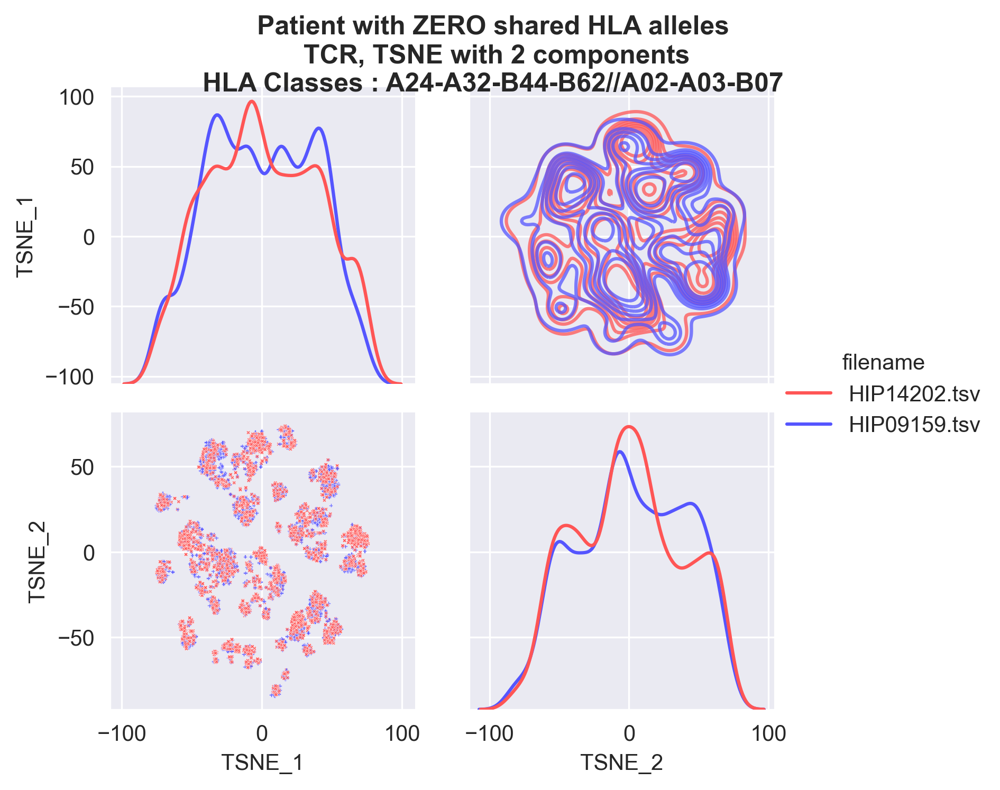

In [183]:
plot_reduc(tmp, hue = 'filename', 
           reduc = 'TSNE',
           name = 'Patient with ZERO shared HLA alleles\n',
           palette = 'seismic_r', comp=False)
plt.savefig(f'../../../meetings/presentation_results/210322_update/no_shared_HLA_top_3k_{reduc}_{masked}_{hue}.jpg', dpi = 300)